### Loading block for epochrun

In [2]:
import numpy as np
import pandas as pd
import matplotlib as mpl
from matplotlib import pyplot
from time import sleep
from scipy import signal
import pandas as pd
import cProfile
import pstats
import sqlite3
import code
import pickle
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

import itertools 

# the main function used to generate Sugarscape dynamics
def epochrun(time_steps, turtle_num, max_capacity, max_meta, max_vision, multi_dim_summary=False):

    def main():
        
        # the size of the board
        size = 50
        time_steps = 100

        # population of agents
        turtle_num = 100 

        # create the board
        environ = Environment(size, max_capacity) # specify the maximum capacity

        # init the turtles
        turts = Turtles(size, turtle_num, max_meta, max_vision) # max meta and max vision

        # record initial
        history = History(environ, turts)

        # simulate the game of life
        for t in range(1, time_steps + 1):
            # if all the turtles are dead, stop
            if len(turts.id) == 0:
                break
            #
            # grow patches
            environ.grow()
            #
            # move turtles
            turts.move(environ)
            #
            # record state
            history.record(environ, turts, t)
        
        # Retrieve the data
        patches, turtle_time, turtle_genetics = history.get_data()
        
        # save simulation
        history.save()
        history.get_data()

        if multi_dim_summary == False:
            # generate snapshots of survival population
            summary = turtle_time.query('time==100').shape[0]
        else:
            num_nonempty_land = []
            for i in range(1,6):
                a = patches[20*i, :,:]
                b = np.where(a==0, 1, 0)
                num_nonempty_land.append(b.sum())
            summary = [turtle_time.query(f'time=={r*20}').shape[0] for r in range(1,6)] + num_nonempty_land
            summary = np.array(summary)
        return patches, turtle_time, turtle_genetics, summary

    class Environment:
        '''
        A 2D area explored by animal, containing 2D qualities of sugar level, sugar capacity, and sugar regeneration.
        '''

        def __init__(self, size, capacity, alpha=1):
            '''
            Initializes the landscape and patches
            Inputs:
                size
                capacity
                alpha - growback rule
            '''
            
            # Initialize the board size
            self.size = size
            if type(size) == int:
                # if integer provided, return square environment
                self.size = (size, size) 
            # self.size = np.array(size, dtype=int)

            # patch properties:
            # self.capacity = np.ones(self.size) * capacity # uniform capacity
            self.capacity = np.random.randint(0, capacity + 1, size = self.size) # random capacity
            # the amount of sugar in each patch is random
            self.level = np.random.randint(0, capacity + 1, size = self.size)
            # ensure that the amount of sugar in a patch doesn't exceed its capacity:
            self.level = np.minimum.reduce([self.level,self.capacity])

            # growback
            self.growback = alpha


        def grow(self):
            '''
            sugar levels grow back
            '''
            # immediate full growback
            # self.level = self.capacity

            # increase by 1 each time, if the current level is not at capacity
            self.level = np.minimum.reduce([self.level + 1, self.capacity])

            # no growth
            # self.level = self.level


    class Turtles:
        '''
        Turtles with position in environment, amount of sugar, it's metabolism, and vision
        Methods and instances for turtles
        '''

        def __init__(self, size, turtle_num, metabolism_max, vision_max):
            
            # list of turtles
            self.id = np.array(range(turtle_num))

            # randomly generate position
            self.x = np.random.randint(0, size, turtle_num)
            self.y = np.random.randint(0, size, turtle_num)
            
            # characteristics
            self.metabolism = np.random.randint(1, metabolism_max + 1, turtle_num)
            self.vision = np.random.randint(1, vision_max + 1, turtle_num)
            self.holding = np.random.randint(5, 25, turtle_num)


        def move(self, environ):
            '''
            Loop through the agents and move them
            '''
            for i in self.id:
                # move turtle
                self.movement(i, environ)
                # eat
                self.holding[i] = self.holding[i] - self.metabolism[i] + environ.level[self.x[i], self.y[i]]
                # update patch sugar level
                environ.level[self.x[i], self.y[i]] = 0
                # die due to insufficiency
                if self.holding[i] <= 0:
                    self.id = self.id[self.id != i]



        def movement(self, i, environ):
            '''
            Movement rule:
                look as far as vision permits in the cardinal directions
                identify site(s) with max sugar
                go to closest site with max sugar
                collect all the sugar
            '''
            # turtle properties
            x, y = self.x[i], self.y[i]
            view = self.vision[i] + 1
            patches = environ.level.copy()
            size = patches.shape[0]

            # only keep unoccupied patches from consideration
            occupied_x = self.x[self.id[self.id != i]]
            occupied_y = self.y[self.id[self.id != i]]
            try:
                patches[occupied_x, occupied_y] = -1
            except:
                code.interact(local = locals())

            # code.interact(local = locals())
            # mask environ with kernel and set -1
            mask = np.ones(environ.size, dtype = bool)
                # set the vision region to false
            mask[x, max(y - view, 0) : min(size, y + view)] = False
            mask[max(x - view, 0) : min(size, x + view), y] = False
                # set everything outside vision to -1
            patches[mask] = -1

            # find index of maximum
            # if statement when len > 1
            idx = np.where(patches == np.amax(patches))
            # import code
            # code.interact(local = locals())
            if len(idx[0]) > 1:
                # choose closest
                dist_x = abs(idx[0] - x)
                dist_y = abs(idx[1] - y)
                dist = dist_x + dist_y
                sites = np.where(dist == np.amin(dist))
                # if there are multiple min dist sites equally attractive, pick randomly
                if len(sites[0]) > 1:
                    # choose a random interval 
                    r = np.random.randint(0,len(sites[0]))
                    try:
                        sites = sites[0][r]
                    except:
                        code.interact(local = locals())
                # choose the idx
                idx = (idx[0][sites], idx[1][sites])
                                
            # move
            self.x[i] = int(idx[0])
            self.y[i] = int(idx[1])

    class History:
        '''
        Stores the historical states
        '''
        def __init__(self, environ, turts):
            '''
            create the historical records
            '''
            # reshape levels and save
            self.patches = np.reshape(environ.level, (1,) + environ.level.shape)
            # prepare the df for the time step
            self.turtles_time = self.turtle_properties_df(turts, time = 0)
            # add the genetic df
            genetic_df = pd.DataFrame({'id' : turts.id, 
                                    'metabolism':turts.metabolism,
                                    'vision':turts.vision})
            genetic_df = genetic_df.set_index('id')
            self.turtles_genetic = genetic_df

        def record(self, environ, turts, time):
            '''
            record the states
            '''
            # record sugar level
            self.record_environment(environ)

            # record turtle position and state
            self.turtles_time = pd.concat([self.turtles_time, self.turtle_properties_df(turts, time)])
        

        def record_environment(self, environ):
            '''
            record the environment state
            # append the environment to the historical
            '''
            # make the 2d array 3d
            environ = np.reshape(environ.level, (1,) + environ.level.shape)

            # append to history
            self.patches = np.append(self.patches, environ, axis=0)


        def turtle_properties_df(self, turts, time):
            '''
            turn the turtle properties to a df
            '''
            # create data dic
            d = {'id' : turts.id, 
            'time' : np.ones(len(turts.id)) * int(time), 
            'x' : turts.x[turts.id], 
            'y' : turts.y[turts.id], 
            'holding' : turts.holding[turts.id],
            'alive' : np.ones(len(turts.id), dtype = bool)
            }
            # put into df
            try: 
                turtTime_df = pd.DataFrame(d)
            except:
                code.interact(local = locals())
            # turtTime_df = turtTime_df.set_index(['id', 'time'])
            
            return turtTime_df


        def save(self):
            '''
            pickle the results
            '''
            # save the array
            np.savez_compressed('/result_patches.npy', data=self.patches)

            # save the pandas dataframes
            with open('result_genetic.npy', 'wb') as fid:
                pickle.dump(self.turtles_genetic, fid)
            with open('result_turtles.npy', 'wb') as fid:
                pickle.dump(self.turtles_time, fid)
            with open('result_patches.npy', 'wb') as fid:
                pickle.dump(self.patches, fid)

        
        def get_data(self):
            self.final_time_turtles = self.turtles_time[self.turtles_time.time==time_steps]

            return self.patches, self.turtles_time, self.turtles_genetic

    if __name__ == '__main__':
        patches, turtle_time, turtle_genetics, summary = main()

    return patches, turtle_time, turtle_genetics, summary

### epochrun for float input

In [2]:
from math import floor, ceil
# ^ is xor gate, true when (1,0)/(0,1), false when (1,1) or (0,0)

def epochrun_float(time_steps, turtle_num, capacity, meta, vision): # function allowed meta and vision to be float types
    if (meta>4) or (vision>16):
        raise ValueError('The input parameters are invalid')
    
    # if both meta and vision are int types:
    if np.allclose([meta, vision], [floor(meta), floor(vision)]):
        return epochrun(time_steps, turtle_num, capacity, meta, vision)[-1]
    # elif one of parameters is int, the other is not
    
    elif np.isclose(meta, floor(meta)) and np.isclose(vision, floor(vision))==False:
        y1, y2 = floor(vision), ceil(vision)
        x,y = meta, vision
        q1, q2 = epochrun(100, 100, 4, x, y1)[-1], epochrun(100, 100, 4, x, y2)[-1] 
        return ((y2-y)*q1 + (y-y1)*q2) / (y2-y1)
    elif np.isclose(vision, floor(vision)) and np.isclose(meta, floor(meta))==False:
        x1, x2 = floor(meta), ceil(meta)
        x, y = meta, vision
        q1, q2 = epochrun(100, 100, 4, x1, y)[-1], epochrun(100, 100, 4, x2, y)[-1] 
        return ((x2-x)*q1 + (x-x1)*q2) / (x2-x1)
    else:
        # for float input, use bilinear interpolation
        x, y = meta, vision
        x1, x2, y1, y2 = floor(x), ceil(x), floor(y), ceil(y)
        print(f'x,y are:{x, y}')
        print(f'x1,x2,y1,y2 are {x1,x2,y1,y2}')
        q11, q12 ,q21, q22 = (x1, y1), (x1, y2), (x2, y1), (x2, y2)
        data, f = {}, {}
        for item in [q11, q12, q21, q22]:
            d1,d2,d3,d4 = epochrun(100, 100, 4, item[0], item[1])
            data[item] = d4
            f[item] = d4 # f only record summary statistics

        a = ( (x2-x)*f[q11] + (x-x1)*f[q21] ) /(x2-x1) # f(x, y1)
        b = ( (x2-x)*f[q12] + (x-x1)*f[q22] ) /(x2-x1) # f(x, y2)

        res = ( (y2-y)*a + (y-y1)*b ) /(y2-y1)

        return res
  

save the artificial real-world data as observation, generated by (max_metabolism = 4, max_vision = 6, time_steps=100, agents=100)

extract the summary statistics (outcome for measuring the error) as the number of survivals at varying timesteps range(0, 200, 20)

In [3]:
# run a simulation 
patches, turtle_time, turtle_genetics, summary = epochrun(100, 100, 4, 4, 6)
# saved as observation 
observation = [patches, turtle_time, turtle_genetics, summary]

np.savez_compressed('/obser_patches.npy', data=patches)
np.savez_compressed('/obser_turtle_time.npy', data=turtle_time)
np.savez_compressed('/obser_turtle_genetics.npy', data=turtle_genetics)

with open('/obser_patches.npy', 'wb') as fid:
    pickle.dump(patches, fid)
with open('/obser_turtle_time.npy', 'wb') as fid:
    pickle.dump(turtle_time, fid)
with open('obser_turtle_genetics.npy', 'wb') as fid:
    pickle.dump(turtle_genetics, fid)

D:\TEMP\ipykernel_22404\3923330052.py:198: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self.x[i] = int(idx[0])
D:\TEMP\ipykernel_22404\3923330052.py:199: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self.y[i] = int(idx[1])


**Load the data**

**There are two parameters that we wish to explore. These are:**

• The maximum possible metabolism of an agent

• The maximum possible vision of an agent

Both of these parameters take integer values, and the minimum metabolism or vision an agent may have is 1. The metabolism and vision given to an agent is a random integer between 1 and the calibrated maximum.


#### ABC

**HM**

Sample from the parameter space. For each sample x_n, run K times. The primary data is N by K.

In [4]:
simulation = {}
K = 5

import itertools
full_space = itertools.product(range(1,5,1), range(1,11,1))
full_space = [k for k in full_space]

# for item in para_space:
#     result = []
#     print(f'simulation for {item}...')
#     # for each sampled parameter set, run K times 
#     for _ in range(K):
#         patches, turtle_time, turtle_genetics, summary = epochrun(100, 100, 4, item[0], item[1])

#         result.append(summary)
#     simulation[item] = result


##### error function, and compute $E^{r}_{K}(x_n)$, the average model error across the ensembles for $x_n$**



In [5]:
# observation_statistics = observation[3]
observation_statistics = 78

def error(b):
    return abs(observation_statistics-b)

N = len(full_space)
# ens_errors = [[error(k) for k in simulation[item]] for item in full_space] # length N, each element has k lengths

# # the list of mean error for each parameter 
# ens_means = [np.mean(k) for k in ens_errors] # length N

**put altogether computing the quantified uncertainties**

In [10]:
def ensem_var(space):
    simulation = {}
    K = 10
    N = len(space)

    for item in space:
        result = []
        # for each sampled parameter set, run K times 
        for _ in range(K):
            patches, turtle_time, turtle_genetics, summary = epochrun(100, 100, 4, item[0], item[1])

            result.append(summary)
        simulation[item] = result
    print('compute the ensemble variance, finish N*k sampling for the current space')
    observation_statistics = observation[3]
    
    ens_errors = [[error(k) for k in simulation[item]] for item in space] # length N, each element has k lengths

    # the list of mean error for each parameter 
    ens_means = [np.mean(k) for k in ens_errors] # length N

    # compute the unbiased estimate of variance $d()$

    sqr_errors = [[(ens_errors[j][k] - ens_means[j])**2 for k in range(K)] for j in range(N)] # N*K
    param_unbiased_esti = [sum(item)/(K-1) for item in sqr_errors] # length N

    ens_vars = sum(param_unbiased_esti)/(N-1)
    return ens_vars, simulation

# use the previous simultion
def model_discrepancy(space, simulation):
    simulation_epoch1 = [simulation[item][0] for item in space]
    error_epoch1 = [error(item) for item in simulation_epoch1]
    model_mean_error = np.mean(error_epoch1)

    # the unbiased estimator of the model across all parameters
    model_vars = sum([(k - model_mean_error)**2 for k in error_epoch1])/(N-1)
    return model_vars

**Then, we can compute the ensemble variance**

In [ ]:
# compute the unbiased estimate of variance $d()$

sqr_errors = [[(ens_errors[j][k] - ens_means[j])**2 for k in range(K)] for j in range(N)] # N*K
param_unbiased_esti = [sum(item)/(K-1) for item in sqr_errors] # length N

ens_vars = sum(param_unbiased_esti)/(N-1)
print('The ensemble variance is:', ens_vars)

The ensemble variance is: 3.75079365079365


**Model discrepancy, run the model only once so we fetch the simulation in epoch 1**

In [ ]:
simulation_epoch1 = [simulation[item][0] for item in para_space]
error_epoch1 = [error(item) for item in simulation_epoch1]
model_mean_error = np.mean(error_epoch1)

# the unbiased estimator of the model across all parameters
model_vars = sum([(k - model_mean_error)**2 for k in error_epoch1])/(N-1)
print('The model discrepancy is:', model_vars)

The model discrepancy is: 81.90079365079364


**threshold for HM**


In [ ]:
from scipy.stats import qmc
from math import floor

# define the number of waves to proceed
num_waves = 10
total_uncertainty = model_vars+ens_vars

def _implaus(y, total_uncertainty):
    """ Calculate the implausibility of the parameter x."""
    num = error(y)  # no emulator, only simulator
    denom = total_uncertainty**0.5  # only ensemble uncertainty
    return num / denom



NameError: name 'model_vars' is not defined

In [12]:
non_implausible_space = np.load('./non_implausible_space.npy', allow_pickle=True)
current_size = 64
next_size = 0

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

def print_implau_scores_across_param(space):
    res = []
    for k in space:
        _, _, _, summary = epochrun(100, 100, 4, k[0], k[1])
        res.append((k,_implaus(summary, total_uncertainty)))
    
    return res

wave_count = 0

while (wave_count<11) and (len(non_implausible_space)>12):
    # run a simulation for each sampled parameter, using LHS sampling
    
    samples_wanted_num = floor(len(non_implausible_space)/3)
    sampler = qmc.LatinHypercube(d=2)

    # some parameter sets might be removed from previous waves
    # add more to 1/3 proportion of the size of non_implau_space
    sample_valid = []
    while len(sample_valid) < samples_wanted_num:
        sample = sampler.random(n=samples_wanted_num - len(sample_valid) )
    
        # map the decimal to the integer scale for (max_meta, max_vision)
        sample_int = [(floor(item[0]*4)+1, floor(item[1]*16)+1) for item in sample]
        sample_valid += list(set(sample_int) & set(non_implausible_space))
        print('The valid samples are:', sample_valid)
        
    current_size = len(non_implausible_space)
    print(f'run {wave_count} finish sampling')
    # iteration
    key_and_scores = print_implau_scores_across_param(non_implausible_space)
    non_implausible_space = [item[0] for item in key_and_scores if item[1]<3]
    print('implausibility scores are:', [item[1] for item in key_and_scores])
    
    next_size = len(non_implausible_space)
    print(f'run {wave_count} finish iteration')

    # recompute the ensemble variance
    ens_var, simulation = ensem_var(non_implausible_space)

    # recompute the model discrepancy
    model_var = model_discrepancy(non_implausible_space, simulation)
    
    total_uncertainty = model_vars+ens_vars
    print(f'run {wave_count} finish uncertainty quantization: {total_uncertainty}')
    print(f'The survived parameter dimension in run {wave_count}:\n', len(non_implausible_space), f'which are: {non_implausible_space}')

    wave_count += 1

print('The survived parameter space:\n', non_implausible_space)

print('The number of parameter sets here is:', len(non_implausible_space))


The valid samples are: [(2, 14), (4, 10), (4, 16), (2, 4), (2, 1), (2, 7), (1, 5), (1, 1), (4, 6), (4, 2), (1, 4), (2, 13), (2, 9), (4, 8), (1, 16), (3, 12), (3, 15), (3, 11)]
The valid samples are: [(2, 14), (4, 10), (4, 16), (2, 4), (2, 1), (2, 7), (1, 5), (1, 1), (4, 6), (4, 2), (1, 4), (2, 13), (2, 9), (4, 8), (1, 16), (3, 12), (3, 15), (3, 11), (3, 12), (1, 8), (4, 3)]
run 0 finish sampling
implausibility scores are: [3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.673763619928218, 3.4576598775794998, 3.5657117487538588, 3.673763619928218, 3.5657117487538588, 3.673763619928218, 3.673763619928218, 3.5657117487538588, 3.673763619928218, 3.5657117487538588, 3.673763619928218, 3.673763619928218, 3.5657117487538588, 3.673763619928218, 3.67376361992821

**2nd approach for HM**

In [41]:
import multiprocessing as mp
import math
ensemble_samples = 10  # total samples used to average ensemble variance

# Initially uknown and automatically calculated:
ens_var = 0  # ensemble variance
model_disc = 0  # model discrepancy
total_uncertainty = 0  # sum of all uncertainties
obs_var = 0

def error_func(r):
    return abs(r-observation_statistics)

def sim_func(a,b):
    # run the simulation
    res = epochrun(a,b)
    return res[3]

def variety_func(X):
    """ Run the model with a set of parameters X, each run once.

    This will need to be overridden if using a netlogo model. """
    pool = mp.Pool(mp.cpu_count())
    Y = pool.map(sim_func, X)
    pool.close()
    return Y

def is_all_plausible(prev_plaus_space, new_plaus_space):
    """ Stopping criteria. Test if no new implausible space was found."""
    # If they're the same size, they must be the same
    return len(prev_plaus_space) == len(new_plaus_space)

def run_k_times(x):
    """ Run the parameters x a total of k times. """
    return [sim_func(x) for _ in range(k)]


def ensemble_func(X, k):
    """ Run the model each parameter set in X a total of k times.

    This will need to be overridden if using a netlogo model. """
    pool = mp.Pool(mp.cpu_count())
    Y = pool.map_async(run_k_times, X).get()
    pool.close()
    return Y

def recalculate_uncertainties(X):
    """ Calculate the average uncertainties across inputs X.

    Each value x in X represents a different input parameter to test.
    Returns: (average ensemble variance across X,
              average model discrepancy across X)
    """
    vars = []
    discrepancies = []
    all_X_run_results = ensemble_func(X, ensemble_samples)
    for run_results in all_X_run_results:
        errors = [error_func(r) for r in run_results]
        vars.append(np.var(errors, ddof=1))
        #discrepancies.append(np.mean(errors))
        discrepancies.append(np.var(errors, ddof=1))
    globals()['ens_var'] = np.mean(vars)
    globals()['model_disc'] = np.mean(discrepancies)
    globals()['total_uncertainty'] = ens_var + obs_var + model_disc


def wave(plaus_space):
    """ Run a wave of history matching.

    plaus_space is (for now) a list of discrete points.
    Returns the new plausible points found in plaus_space
    plus the implausibility scores.
    """
    # Get the new ensemble variance using a selection of three inputs from X,
    # where these inputs are evenly spread across the plausible space.
    # TODO: an optimised design, such as LHS, would be preferred.
    print('Getting ensemble variance...')
    test_space = [plaus_space[i]
                 for i in range(0,
                                len(plaus_space),
                                math.ceil(len(plaus_space)/ensemble_samples))]
    recalculate_uncertainties(test_space)
    new_plaus_space = []
    print('Getting implausibility scores...')
    Y = variety_func(plaus_space)
    implaus_scores = [_implaus(y) for y in Y]
    for i in range(len(plaus_space)):
        if implaus_scores[i] < 3:
            new_plaus_space.append(plaus_space[i])
    return total_uncertainty, new_plaus_space, implaus_scores

In [13]:
from itertools import product
import matplotlib.pyplot as plt

plaus_metabolism = range(1, 5)
plaus_vision = range(1, 17)
plaus_space = []  # not yet explored
new_plaus_space = list(product(plaus_metabolism, plaus_vision))

def plot_wave(wave, show=True):
    plt.clf()
    plaus_space = wave['plaus_space']
    implaus_scores = wave['implaus_scores']
    X2 = range(1, 17)
    X1 = range(1, 5)
    Z = np.empty((len(X1), len(X2)))
    for i1 in range(len(X1)):
        for i2 in range(len(X2)):
            x1 = X1[i1]
            x2 = X2[i2]
            try:
                if implaus_scores[plaus_space.index((x1, x2))] < 3:
                    Z[i1][i2] = 0
                else:
                    Z[i1][i2] = 3
            except ValueError:
                # unexplored implausible space
                Z[i1][i2] = 3
    im = plt.imshow(Z, cmap=None)
    plt.gca().invert_yaxis()
    plt.yticks(range(len(X1)), X1)
    plt.xticks(range(len(X2)), X2)
    plt.xlabel('max vision')
    plt.ylabel('max metabolism')
    plt.subplots_adjust(bottom=0.15)
    if show:
        plt.show()

while not is_all_plausible(plaus_space, new_plaus_space):
    plaus_space = new_plaus_space
    new_plaus_space, implaus_scores = wave(plaus_space)
    plot_wave(plaus_space, implaus_scores, ('vision','metabolism'))

Getting ensemble variance...


**ABC after HM**

The final non-implausible space found through HM is used as a uniform prior for ABC

$\epsilon = 3(V_{o} + V_{s} + V_{m})$, in the sugarscape model we regard $V_{o}=0$, we here propose use the last recent uncertainty as the initial choice for $\epsilon$

Return: a posterior distribution over the non-implausible parameter spa

Theoretically, a small $\epsilon$ forces the sampling distribution to the true posterior, a large value (most simulation from the sampled parameter would be accepted) leads to the prior distribution itself (where we sample the parameter).

**Load the plot function**

In [6]:
# obs = 66
yticks = range(1, 6)
xticks = range(1, 12)

def plot_results(theta=None):
    fig, axes = plt.subplots(1, 1, figsize=(9, 3))

    N = len(theta)
    # are weight necessary?
    W = [1 for i in range(N)]
    X = [t[1] for t in theta]
    Y = [t[0] for t in theta]
    p = plt.hist2d(x=X, y=Y, weights=W, density=True,
                   bins=((xticks, yticks)), cmap='magma')
    plt.xlabel('max vision', fontsize=16)
    plt.ylabel('max metabolism', fontsize=14)
    plt.xticks([x+0.5 for x in xticks[:-1]], xticks[:-1], fontsize=12)
    plt.yticks([y+0.5 for y in yticks[:-1]], yticks[:-1], fontsize=12)
    plt.colorbar(p[3])
    fig.tight_layout()
    #plt.show()


# with open('results/%s/abc_reject.pkl' % run_id, 'wb') as pfile:
        # hm_results = pickle.dump(results, pfile)

# plot_results(res)
# plt.savefig(f'E:/Imperial 2023-24/project!!/sugarscape/abc_reject_results_{N}_acceptance_threshold_10.jpg')


##### abc+hm, rejection sampling: Here we choose acceptance threshold as 10, expect a biased posterior.

1th sample accepted, time 14.298366785049438
2th sample accepted, time 13.679604530334473
3th sample accepted, time 23.280973434448242
4th sample accepted, time 13.565668821334839
5th sample accepted, time 13.512902975082397
6th sample accepted, time 13.216885566711426
7th sample accepted, time 13.396052122116089
8th sample accepted, time 13.752056121826172
9th sample accepted, time 23.99491548538208
10th sample accepted, time 13.238692998886108
11th sample accepted, time 12.120202541351318
12th sample accepted, time 11.649810791015625
13th sample accepted, time 13.099120616912842
14th sample accepted, time 12.783622741699219
15th sample accepted, time 13.724881410598755
16th sample accepted, time 14.210350036621094
17th sample accepted, time 11.630518198013306
18th sample accepted, time 25.675492525100708
19th sample accepted, time 13.523303747177124
20th sample accepted, time 12.672346353530884
21th sample accepted, time 24.348867416381836
22th sample accepted, time 13.50723814964294

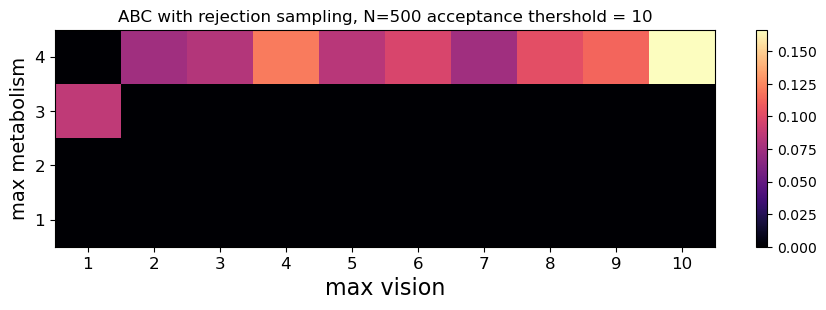

In [7]:
import numpy as np
import random
import time
import multiprocessing as mp
import pickle
import matplotlib.pyplot as plt

non_implausible_space = np.load('E:/Imperial 2023-24/project!!/sugarscape/non_implausible_space.npy', allow_pickle=True)
total_uncertainty = np.load('E:/Imperial 2023-24/project!!/sugarscape/total_uncertainty.npy', allow_pickle=True)

obs_ls = [80]
yticks = range(1, 6)
xticks = range(1, 12)

plaus_space, uncert = non_implausible_space, 10

N = 500  # number of particles

abc_threshold = []
attempts = [0]*N
times = [0]*N
errors_threshold = [0]*N
for obs in obs_ls:
    for _ in range(N):
        d = uncert + 1 
        attempt = 0
        a = time.time()

        while d > uncert:
            sample = plaus_space[random.randint(0, len(plaus_space)-1)]
            x = np.mean([epochrun(100, 100, 4, sample[0], sample[-1])[-1] for k in range(5)]) # simulate data, take the mean at a certain param
            d = abs(obs - x)
            attempt += 1
        #  if attempt > 10:
        #     uncert = min(uncert+5, 15)
        #  elif attempt<5:
        #     uncert = max(10, uncert-5) 
        b = time.time()
        times[_] = b -a
        
        attempts[_] = attempt
        errors_threshold[_] = d

        print(f'{_+1}th sample accepted, time {b-a}')
        abc_threshold.append((sample, x)) # record the parameter and averaged simulation at theta
        # print(f'error:{d}, the data {x} with sample {sample}')
    
    plot_results([r[0] for r in abc_threshold])
    plt.title(f'ABC with rejection sampling, N={N} acceptance thershold = {uncert}')
    plt.savefig(f'E:/Imperial 2023-24/project!!/sugarscape/abc_with_hm/rejabc/abc_reject_results_N={N}_obs{obs}_acceptance_threshold_{uncert}.jpg')

    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_with_hm/rejabc/abc_reject_attempts_N={N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
        pickle.dump(attempts, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_with_hm/rejabc/abc_reject_errors_N={N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
        pickle.dump(errors_threshold, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_with_hm/rejabc/abc_reject_results_N={N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
        pickle.dump(abc_threshold, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_with_hm/rejabc/abc_reject_timetaken_N={N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
        pickle.dump(times, fid)

##### better control over CPU resources for: ABC rejection sampling after HM*

In [30]:
""" ABC rejection sampling. """

def abc(_):
    d = uncert + 1  # initialise d to be greater than the tolerance threshold
    attempts = 1
    while d > uncert:
        # sample from the prior
        sample = plaus_space[random.randint(0, len(plaus_space)-1)]
        x = epochrun(sample)[-1]  # simulate data
        d = abs(obs - x)
        attempts += 1
    return sample, attempts, d  # store the accepted value


# run the algorithm
def run_it():
    a = time()
    pool = mp.Pool(mp.cpu_count())
    results = pool.map_async(abc, range(N)).get()
    pool.close()
    b = time()
    print('Total time:', round(b - a))
    return results


def plot_results(theta=None):
    fig, axes = plt.subplots(1, 1, figsize=(9, 3))
    # are weight necessary?
    W = [1 for i in range(N)]
    X = [t[1] for t in theta]
    Y = [t[0] for t in theta]
    p = plt.hist2d(x=X, y=Y, weights=W, density=True,
                   bins=((xticks, yticks)), cmap='magma')
    plt.xlabel('max vision', fontsize=16)
    plt.ylabel('max metabolism', fontsize=14)
    plt.xticks([x+0.5 for x in xticks[:-1]], xticks[:-1], fontsize=12)
    plt.yticks([y+0.5 for y in yticks[:-1]], yticks[:-1], fontsize=12)
    plt.colorbar(p[3])
    fig.tight_layout()
    #plt.show()
    #plt.savefig('/abc_reject_results.pdf')


results = run_it()
# with open('results/%s/abc_reject.pkl' % run_id, 'wb') as pfile:
        # hm_results = pickle.dump(results, pfile)

theta = [r[0] for r in results]
total_attempts = sum([r[1] for r in results])
print('Total attempts:', total_attempts)
plot_results(theta)
#plot_results()

##### ABC without HM

In [4]:
def plot_results(theta=None):
    fig, axes = plt.subplots(1, 1, figsize=(9, 3))
    # are weight necessary?
    N = len(theta)
    W = [1 for i in range(N)]
    X = [t[1] for t in theta]
    Y = [t[0] for t in theta]
    p = plt.hist2d(x=X, y=Y, weights=W, density=True,
                   bins=((xticks, yticks)), cmap='magma')
    plt.xlabel('max vision', fontsize=16)
    plt.ylabel('max metabolism', fontsize=14)
    plt.xticks([x+0.5 for x in xticks[:-1]], xticks[:-1], fontsize=12)
    plt.yticks([y+0.5 for y in yticks[:-1]], yticks[:-1], fontsize=12)
    plt.colorbar(p[3])
    fig.tight_layout()

In [13]:
import matplotlib.pyplot as plt
asa = [epochrun(100, 100, 4, 4, 6)[-1] for r in range(500)]

Text(0.5, 1.0, 'Final survival count from simulations generated by (4,6) with 1000 repeated runs')

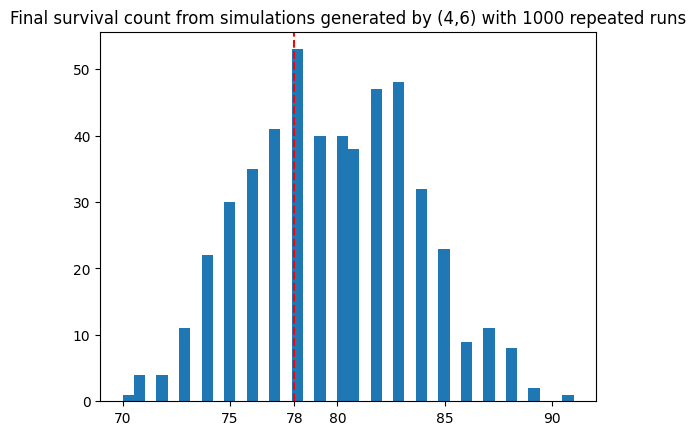

In [28]:
plt.hist(asa,bins=40) # inspect the distribution of (4,6) survival, equal to 66?
plt.axvline(78, color="red", linestyle="--", label="Highlighted Attempt")
plt.xticks([70, 75, 78, 80, 85, 90])
plt.title('Final survival count from simulations generated by (4,6) with 1000 repeated runs')

observation=78:
1th sample accepted: (4, 5). using attempts 2, time 27.699958562850952, current threshold 10
2th sample accepted: (4, 4). using attempts 4, time 49.5633180141449, current threshold 10
3th sample accepted: (4, 10). using attempts 1, time 13.568448543548584, current threshold 10
4th sample accepted: (4, 9). using attempts 1, time 12.152487754821777, current threshold 10
5th sample accepted: (4, 1). using attempts 1, time 9.692822933197021, current threshold 10
6th sample accepted: (4, 2). using attempts 1, time 10.501750707626343, current threshold 10
7th sample accepted: (4, 7). using attempts 4, time 48.81350612640381, current threshold 10
8th sample accepted: (4, 4). using attempts 4, time 50.46746373176575, current threshold 10
9th sample accepted: (4, 3). using attempts 3, time 37.52095603942871, current threshold 10
10th sample accepted: (4, 10). using attempts 2, time 26.659177541732788, current threshold 10
11th sample accepted: (4, 3). using attempts 2, time 23.8

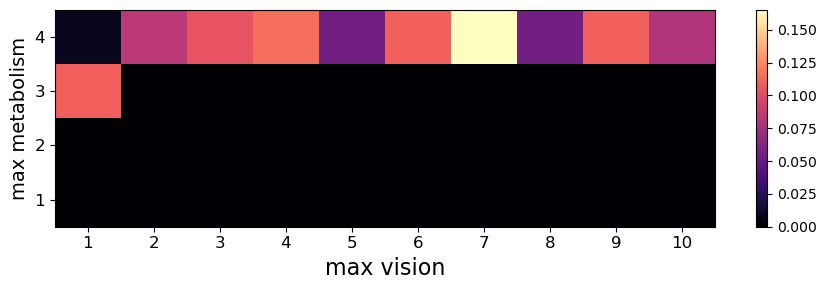

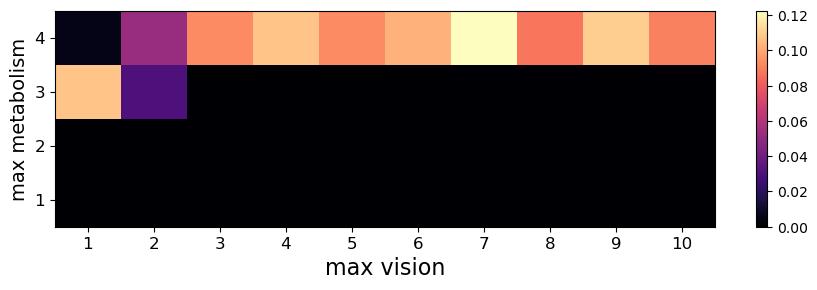

In [134]:
import time 
full_space = itertools.product(range(1,5), range(1,11))
full_space = [r for r in full_space]
plaus_space, uncert = full_space, 10 # adapting the threshold in further iterations

# set parameters, specify functions and initialise storage objects
N = 200 # number of particles
obs_ls = [78, 82]
theta = np.zeros(N)  # particle results

res_threshold10 = []
attempts = [0]*N
times = [0]*N
errors_threshold = [0]*N
for obs in obs_ls:
  print(f'observation={obs}:')
  for _ in range(N):
      d = uncert + 1 
      attempt = 0
      a = time.time()

      while d > uncert:
          sample = plaus_space[random.randint(0, len(plaus_space)-1)]
          x = np.mean([epochrun(100, 100, 4, sample[0], sample[-1])[-1] for k in range(5)]) # simulate data, take the mean at a certain param
          d = abs(obs - x)
          attempt += 1
        #  if attempt > 10:
        #     uncert = min(uncert+5, 15)
        #  elif attempt<5:
        #     uncert = max(10, uncert-5) 
      b = time.time()
      times[_] = b -a
      
      attempts[_] = attempt
      errors_threshold[_] = d

      print(f'{_+1}th sample accepted: {sample}. using attempts {attempt}, time {b-a}, current threshold {uncert}')
      res_threshold10.append((sample, x))
      # print(f'error:{d}, the data {x} with sample {sample}')
  
  plot_results([r[0] for r in res_threshold10])
  plt.savefig(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.jpg')
  with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/abc_reject_attempts_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
      pickle.dump(attempts, fid)
  with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/abc_reject_errors_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
      pickle.dump(errors_threshold, fid)
  with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
    pickle.dump(res_threshold10, fid)


**change the value of uncert**

1th sample accepted
2th sample accepted
3th sample accepted
4th sample accepted
5th sample accepted
6th sample accepted
7th sample accepted
8th sample accepted
9th sample accepted
10th sample accepted
11th sample accepted
12th sample accepted
13th sample accepted
14th sample accepted
15th sample accepted
16th sample accepted
17th sample accepted
18th sample accepted
19th sample accepted
20th sample accepted
21th sample accepted
22th sample accepted
23th sample accepted
24th sample accepted
25th sample accepted
26th sample accepted
27th sample accepted
28th sample accepted
29th sample accepted
30th sample accepted
31th sample accepted
32th sample accepted
33th sample accepted
34th sample accepted
35th sample accepted
36th sample accepted
37th sample accepted
38th sample accepted
39th sample accepted
40th sample accepted
41th sample accepted
42th sample accepted
43th sample accepted
44th sample accepted
45th sample accepted
46th sample accepted
47th sample accepted
48th sample accepted
4

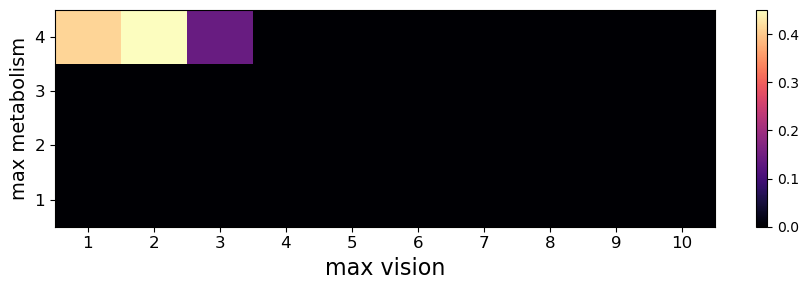

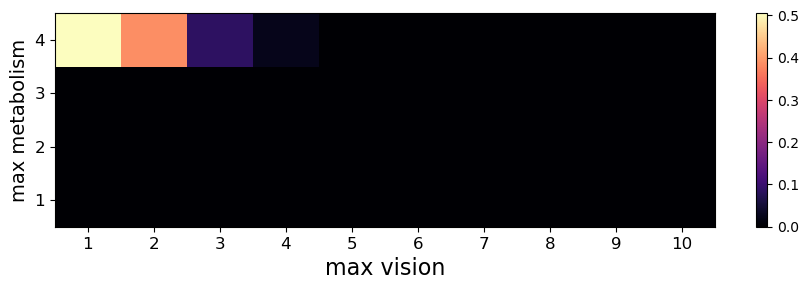

In [66]:
plaus_space, uncert = full_space, 5

# set parameters, specify functions and initialise storage objects

N = 100 
# theta = np.zeros(N)  # particle results

res_threshold10 = []
attempts = [0]*N
errors_threshold = [0]*N

for _ in range(N):
    d = uncert + 1 
    attempt = 0
    while d > uncert:
        sample = plaus_space[random.randint(0, len(plaus_space)-1)]
        x = np.mean([epochrun(100, 100, 4, sample[0], sample[-1])[-1] for k in range(5)]) # simulate data, take the mean at a certain param
        d = abs(obs - x)
        attempt += 1
    attempts[_] = attempt
    errors_threshold[_] = d

    print(f'{_+1}th sample accepted')
    res_threshold10.append(sample)
    # print(f'error:{d}, the data {x} with sample {sample}')

plot_results(res_threshold10)
plt.savefig(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/abc_reject_results_{N}_acceptance_threshold_{uncert}.jpg')
with open(f'abc_reject_attempts_{N}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
    pickle.dump(attempts, fid)
with open(f'abc_reject_errors_{N}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
    pickle.dump(errors_threshold, fid)

#### SMC-ABC: we cite the adaptive update for acceptance threshold by defining various alpha quantile (OR NOT)

##### overview of the eps and perturbation kernel: 

##### Similarly, the choice of the perturbation kernels {Kt(·|·)}1≤t≤T exerts considerable influence on the computational complexity of the algorithm. A local perturbation kernel hardly moves the particles and has the advantage to produce new particles which are accepted with high probability if the successive values of  are close enough; on the other hand, a widely spread out or permissive perturbation kernel enables exploring the parameter space more fully, but does so at the cost of achieving only low acceptance rates.


##### adaptive eps

for the adaptive kernel, considering

$θ = (θ_1, · · · θ_d), θ_j$ is perturbed independently according to a uniform bounded distribution with mean $θ_j$ and variance $σ_j^{2}.$ 

Considering a kernel of perturbing $\theta_{j}^{t}$ to $[\theta_{j}^{t} - \sigma_{j}^{t}, \theta_{j}^{t} + \sigma_{j}^{t}]$ with density $\frac{1}{2 \sigma_{j}^{t}}$
A common choice for $\sigma_{j}^{t}$ is:

$\sigma_{j}^{t} \sim \frac{1}{2} \biggl\{ \max_{1 \leq k \leq N} \sigma_{j}^{(k, t-1)} - \min_{1 \leq k \leq N} \sigma_{j}^{(k, t-1)} \biggr\} $

And for the component independent gaussian:

$K_{t}(\theta^{t}|\theta^{t-1}) = \prod_{j=1}^{d} \frac{1}{\sqrt{2 \pi} \sigma_{j}^{t} } \exp{- \frac{(\theta_{j}^{t} - \theta_{j}^{t-1})^{2}} {2 (\sigma_{j}^{t})^{2}}}$


##### define kernels

In [38]:
# define two kernels: uniform and component wise gaussian
from scipy.stats import norm
np.random.seed(42)

class com_wise_gaussian_kernel():
    def __init__(self, theta_tminus, weight_tminus, accepted_tminus, N, theta_from_weight):
        super().__init__()
        self.theta_tminus = theta_tminus
        self.weight_tminus = weight_tminus
        self.accepted_tminus = accepted_tminus # list of boolean values indicating value y^{(t-1)} are close enough to be accepted
        self.theta_from_weight = theta_from_weight

        # approx the components' variances
        accept_pairs = [(self.theta_tminus[r], self.weight_tminus[r]) for r in range(N) if self.accepted_tminus[r] ] 
        weight_sum = sum([r[1] for r in accept_pairs])
        accept_pairs = [(r[0], r[1]/weight_sum) for r in accept_pairs]
        N0 = len(accept_pairs)

        approx_std = [0]*2
        for j in range(2):
            sumit = 0
            for i in range(N):
                for k in range(N0):
                    sumit += self.weight_tminus[i] * accept_pairs[k][1] * (self.theta_tminus[i][j] - accept_pairs[k][0][j])**2
            approx_std[j] = sumit**(0.5)
        self.approx_std = np.array(approx_std)

    def prob(self, y):
        prob = 1
        k = 2
        for j in range(2):
            norm_func = norm(loc=self.theta_from_weight[j], scale = self.approx_std[j])
            prob *= norm_func.pdf(y[j])
        
        return prob
    
    def generator(self):
        """
        x: the input specifying the mean of dim-2 proposal

        approx_std is a (2,) np.array
        """
        # x = np.squeeze(np.array(x))
        return np.array([norm(loc=self.theta_from_weight[j], 
                              scale = self.approx_std[j]).rvs(1) for j in range(2)])
    
    def return_scale(self):
        return self.approx_std

class uniform_kernel():
    def __init__(self, theta_t, theta_tminus, N):
        super().__init__()
        self.theta_tminus = theta_tminus    
        self.theta_t = theta_t

        approx_std= [0]*2
        for j in range(2):
            approx_std[j] = 0.5 * (max([theta_tminus[k][j] for k in range(N)]) - min([theta_tminus[k][j] for k in range(N)]) )

        self.approx_std = approx_std

    def generator(self):
        return np.array([np.random.uniform(low = self.theta_t[j] - self.approx_std[j],
                                           high = self.theta_t[j] + self.approx_std[j], size = 1) for j in range(2)])

    def prob(self, x):
        return 1/(4*self.approx_std[0]*self.approx_std[1])
        
    def return_scale(self):
        return self.approx_std

##### define the main loop for smc_abc

In [51]:
from typing import Any, Callable, Dict, Optional, Tuple, Union

import numpy as np
import math
np.random.seed(42)
import matplotlib.pyplot as plt 
import time
from numpy import ndarray
import random

# import torch
# from torch import Tensor, ones, tensor
# from torch.distributions import Distribution, Multinomial, MultivariateNormal

import itertools 
from scipy.stats import norm

full_space = [r for r in itertools.product(range(1,5), range(1,11))]
full_space = [np.array(r) for r in full_space]
full_space = [np.reshape(r, (2,)) for r in full_space]

aa = None
def smcabc(T, init_w, N, initial_eps, kernel_gen:str, adapt:bool=False, alpha=None):
    """
        T: number of iterations
        N: number of samples each run t
        initial_eps: threshold for the first run, and for the rest if adapt=False
        kernel_gen: generator to specify the kernel used, a lot to discuss the optimality
        adapt: boolean value to determine whether alpha quantile is used for updating thershold
    """
    t = 0
    population_history = np.ndarray(shape=(T,N), dtype=object)
    noise_population_history = np.ndarray(shape=(T,N), dtype=object)

    weight_history = np.ndarray(shape=(T,N))
    weight_history[0,:] = [1/N]*N

    eps = initial_eps # fixed, unless adapt=true
    eps_history = [initial_eps]
    
    accept_history = np.array([[False]*N ]*T,dtype=object)
    time_history = np.ndarray(shape=(T,N))

    def kernel(s, t, generate_or_pdf=0, theta_time_t=None, N=N): # the kernel is suffix by time t, and its parameters are also variants with t
        """
        generate_or_pdf: 0 stands for generator, 1 for returning a pdf function, 2 for returning the std at time t
        x: value to be calculated the pdf when generate_or_pdf=1, mean value for generation when equal to 0, default set as None
        theta_time_t: theta value before passed to kernel at time t
        """

        if t==0:
            return  
        if s == 'gaussian_component_wise':
            # here, we need all N samples from the last step t-1 to approx. the std for each dimension j in time t 
            kernel = com_wise_gaussian_kernel(theta_tminus=noise_population_history[t-1,:], # size N, each object has dim=2
                                              weight_tminus=weight_history[t-1,:], # size N, each object/scalar has dim=1
                                              accepted_tminus = accept_history[t-1,:] , # size N, each object is boolean value, indicating theta_{i,t-1} accepted or not
                                              N=N, theta_from_weight = theta_time_t)
            if generate_or_pdf ==0:
                return kernel.generator()
            elif generate_or_pdf ==1:
                return kernel.prob(x)
            else:
                return kernel.return_scale()
            
        elif s == 'uniform':
            kernel = uniform_kernel(theta_t = theta_time_t, theta_tminus=population_history[t-1,:], N=N)
            if generate_or_pdf ==0:
                return kernel.generator()
            elif generate_or_pdf ==1:
                return kernel.prob(x)
            else:
                return kernel.return_scale()
        else:
            raise ValueError('no such kernels')
        
    while t<T: # the termination criteria only depends on t
        # the simulation function only takes integer arguments as the resources are distributed on the int grid
        # apply linear interpolation to determine the final survival count: epochrun_float
        print(f'run{t}: \n')
        for _ in range(N):
            errors = []
            accept = False
            a = time.time()
            while accept!=True:
                if t==0: # initial data, namely noise_data
                    theta_from_weight = random.choice(full_space) # shape (2,)
                    # theta_from_weight = np.reshape(theta_from_weight, (2,))
                    noise_theta = theta_from_weight + np.random.normal(size=2)
                    
                    population_history[t,_] = theta_from_weight
                    noise_population_history[t,_] = noise_theta
                else:
                    # sample θ from the previous population                 
                    theta_from_weight = np.random.choice(noise_population_history[t-1,:], size=1, p=weight_history[t-1,:])[0]
                   
                    # add perturbation noise   
                    # initiate the kernel for generation purpose           
                    if kernel_gen == 'gaussian_component_wise':
                        std_t =  np.array([1,1]) if t==1 else kernel(kernel_gen, t, generate_or_pdf=2)
                        print('std_t:', std_t)
                        # here theta_time_t is regarded at the mean of guassian generator
                        perturbation = kernel(s=kernel_gen, theta_time_t = np.array([0,0]), t=t)
                        perturbation = np.reshape(perturbation, (2,))
                        a2 = [round(r, 4) for r in perturbation]
                        print(f'perturbation:', a2)

                        noise_theta = perturbation/(std_t)  + theta_from_weight
                        
                    elif kernel_gen == 'uniform':
                        std_t =  kernel(kernel_gen, t, theta_time_t = theta_from_weight, generate_or_pdf=2)
                        noise_theta = kernel(kernel_gen, t, theta_time_t = theta_from_weight)
                
                print(type(theta_from_weight), theta_from_weight)
                a1 = [round(r.item(), 4) for r in theta_from_weight]
                print(f'theta t:', a1 )
                
                # preprocess the noise theta, make sure it is valid in the range [4,10]
                noise_theta[0], noise_theta[1] = noise_theta[0] % 4, noise_theta[1] % 10
                noise_theta[0], noise_theta[1] = np.clip(noise_theta[0], 1,4).item(), np.clip(noise_theta[1], 1,10).item()
                print('noise theta', noise_theta )
                # print(noise_theta)

                # run simulations from the noise theta\
                sim = epochrun_float(100, 100, 4, noise_theta[0], noise_theta[1]) # summary statistics, scalar
                print('simulation', sim)
                dis = error(sim)
                
                if dis<eps:
                    accept = True
                    accept_history[t,_] = True

            b = time.time()
            time_taken = b - a
            time_history[t,_] = time_taken

            print(f'run{t}, i={_}, time = {time_taken:.4f}, theta from weight={theta_from_weight}, perturbed param is:{noise_theta}, accepted!')
            # update the param history until theta accepted
            population_history[t,_] = theta_from_weight # add tuple because the original input is array
            noise_population_history[t,_] = noise_theta
            errors.append(dis)

        print(f'after run{t}, the accepted parameters are: {noise_population_history[t,:]} \n')
        
        # plot the snapshot of accepted parameters at time t
        # plot_results(noise_population_history[t,:])
        plt.title(f'after run{t}, the accepted parameters by smc_abc')

        # update the eps if adapt=true
        if adapt==True:
            eps = np.quantile(errors, q=alpha) # across N errors
        eps_history.append(eps)

        # update importance weight_history
        # r stands for the new accepted thetas (length N) in time t
        def kernel_density(std:np.array, theta, x):
            """
            std: dim=2, standard deviation for each dimension j in theta
            """
            x, theta = np.array(x), np.array(theta)
            return math.exp(-np.linalg.norm(theta-x, ord=2)**2 / (2*std[1]*std[0]))/(2*math.pi*std[0]*std[1])
        
        weight_new = [0]*N
        for i, r in enumerate(noise_population_history[t,:]): 
            if t==0: std_t = np.array([1,1])
            vec_kernel_density = [kernel_density(std_t, noise_population_history[t,j], r) for j in range(N)]
            weight_new[i] = (1/N) / np.dot(weight_history[t-1,:], vec_kernel_density)
        
        # normalization of prob to 1
        w_sum = sum(weight_new)
        weight_new = [r/w_sum for r in weight_new] 

        t += 1
        if t!=1 and t<T: # except for the initial uniform weight
            weight_new = [r.item() for r in weight_new]
            print('error:', weight_new)
            weight_history[t-1,:] = weight_new
        
    return population_history, noise_population_history, weight_history, eps_history, time_history



###### base case for smc_abc, obs=78, no adaptive eps

In [291]:
T=100
N=10
init_w = [1/N]*N
initial_eps=10
kernel_gen = 'gaussian_component_wise'
adapt=False, 
alpha=None
population_history, noise_population_history, weight_history, eps_history, time_history = smcabc(T, init_w, N, initial_eps=initial_eps, kernel_gen=kernel_gen, 
                                                                                   adapt=adapt, alpha=alpha)

with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(population_history, fid)
with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/noise_parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(noise_population_history, fid)
with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/weight_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(weight_history, fid)
with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/eps_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(eps_history, fid)
with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/time_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(time_history, fid)

run0: 

theta t: [4, 1]
noise theta [3.44659365 1.        ]
simulation 77.85450159258237
run0, i=0, time = 5.0900, theta from weight=[4 1], perturbed param is:[3.44659365 1.        ], accepted!
theta t: [3, 3]
noise theta [3.11058836 3.77664344]
x,y are:(3.1105883564546475, 3.776643443105904)
x1,x2,y1,y2 are (3, 4, 3, 4)


KeyboardInterrupt: 

##### uniform kernel, smc_abc

run0: 

<class 'numpy.ndarray'> [2 9]
theta t: [2, 9]
noise theta [1.         8.26485278]
simulation 100.0
<class 'numpy.ndarray'> [2 5]
theta t: [2, 5]
noise theta [1.         6.20469529]
simulation 100.0
<class 'numpy.ndarray'> [4 7]
theta t: [4, 7]
noise theta [3.07557874 6.39664011]
x,y are:(np.float64(3.075578741585611), np.float64(6.3966401069765695))
x1,x2,y1,y2 are (3, 4, 6, 7)
simulation 96.56273422744053
<class 'numpy.ndarray'> [3 1]
theta t: [3, 1]
noise theta [3.03934714 2.50734461]
x,y are:(np.float64(3.0393471381923685), np.float64(2.5073446063760594))
x1,x2,y1,y2 are (3, 4, 2, 3)
simulation 91.54478466687328
<class 'numpy.ndarray'> [4 1]
theta t: [4, 1]
noise theta [1.73590766 1.        ]
simulation 97.79227700572473
<class 'numpy.ndarray'> [1 2]
theta t: [1, 2]
noise theta [2.11924379 3.20392171]
x,y are:(np.float64(2.1192437860473228), np.float64(3.203921705122242))
x1,x2,y1,y2 are (2, 3, 3, 4)
simulation 98.81867054540534
<class 'numpy.ndarray'> [ 1 10]
theta t: [1, 1

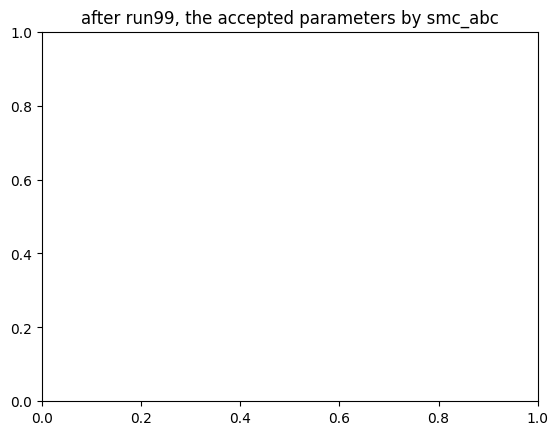

In [53]:
T=100
N=10
init_w = [1/N]*N
initial_eps=10
kernel_gen = 'uniform'
adapt=False, 
alpha = None

population_history, noise_population_history, weight_history, eps_history, time_history = smcabc(T, init_w, N, initial_eps=initial_eps, kernel_gen=kernel_gen, 
                                                                                adapt=adapt, alpha=alpha)

with open(f'E:/project/smc_abc_withouthm_uniform/parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(population_history, fid)
with open(f'E:/project/smc_abc_withouthm_uniform/noise_parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(noise_population_history, fid)
with open(f'E:/project/smc_abc_withouthm_uniform/weight_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(weight_history, fid)
with open(f'E:/project/smc_abc_withouthm_uniform/eps_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(eps_history, fid)
with open(f'E:/project/smc_abc_withouthm_uniform/time_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
    pickle.dump(time_history, fid)

##### smc_abc + gaussian kernel + adaptive eps with alpha quantile =0.9

run0: 

theta t: [1, 2]
noise theta [3.73429344 4.16376701]
x,y are:(3.7342934401179564, 4.163767006178703)
x1,x2,y1,y2 are (3, 4, 4, 5)
simulation 76.62740244210951
run0, i=0, time = 11.7016, theta from weight=[1 2], perturbed param is:[3.73429344 4.16376701], accepted!
theta t: [4, 9]
noise theta [3.72590738 8.34356642]
x,y are:(3.7259073842858386, 8.343566424664635)
x1,x2,y1,y2 are (3, 4, 8, 9)
simulation 90.47503904721269
theta t: [1, 4]
noise theta [1.8203686  2.60121643]
x,y are:(1.8203685969778434, 2.601216426222516)
x1,x2,y1,y2 are (1, 2, 2, 3)
simulation 98.85248188210451
theta t: [4, 5]
noise theta [3.88931908 4.08551117]
x,y are:(3.889319075847339, 4.085511166571928)
x1,x2,y1,y2 are (3, 4, 4, 5)
simulation 83.83101575982977
run0, i=1, time = 28.0519, theta from weight=[4 5], perturbed param is:[3.88931908 4.08551117], accepted!
theta t: [1, 4]
noise theta [2.78241884 3.32158581]
x,y are:(2.782418837475317, 3.321585808714783)
x1,x2,y1,y2 are (2, 3, 3, 4)
simulation 94.3203090

D:\TEMP\ipykernel_232724\4218711395.py:167: RuntimeWarning: overflow encountered in scalar divide
  weight_new[i] = (1/N) / np.dot(weight_history[t-1,:], vec_kernel_density)
D:\TEMP\ipykernel_232724\4218711395.py:171: RuntimeWarning: invalid value encountered in scalar divide
  weight_new = [r/w_sum for r in weight_new]


run1: 

std_t: [1 1]
perturbation: [0.116, 2.7892]
theta t: [3.5312, 2.0465]
noise theta [3.64722394 4.83564466]
x,y are:(3.647223938241994, 4.835644655499891)
x1,x2,y1,y2 are (3, 4, 4, 5)
simulation 81.45738648731974
run1, i=0, time = 7.5289, theta from weight=[3.53117682 2.04649252], perturbed param is:[3.64722394 4.83564466], accepted!
std_t: [1 1]
perturbation: [0.5518, -1.4959]
theta t: [3.3808, 1.0]
noise theta [3.93264748 9.50406676]
x,y are:(3.9326474828118796, 9.50406675628459)
x1,x2,y1,y2 are (3, 4, 9, 10)
simulation 84.03916396234447
run1, i=1, time = 9.0401, theta from weight=[3.38083133 1.        ], perturbed param is:[3.93264748 9.50406676], accepted!
std_t: [1 1]
perturbation: [0.0616, -4.6867]
theta t: [3.7343, 4.1638]
noise theta [3.79585782 9.47711661]
x,y are:(3.795857818406225, 9.477116606029199)
x1,x2,y1,y2 are (3, 4, 9, 10)
simulation 89.47678710319703
std_t: [1 1]
perturbation: [0.9115, -2.1166]
theta t: [3.9683, 9.5063]
noise theta [1.       7.389709]
simulation

D:\TEMP\ipykernel_232724\3846231422.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 1, figsize=(9, 3))


run21: 

std_t: [0.50148029 1.5794227 ]
perturbation: [-0.1017, -0.1659]
theta t: [3.1866, 2.5565]
noise theta [2.98386459 2.4515165 ]
x,y are:(2.983864590792947, 2.4515165049574916)
x1,x2,y1,y2 are (2, 3, 2, 3)
simulation 93.64529595028483
std_t: [0.50148029 1.5794227 ]
perturbation: [0.6259, -2.2346]
theta t: [3.1127, 1.0]
noise theta [1.         9.58519973]
simulation 100.0
std_t: [0.50148029 1.5794227 ]
perturbation: [-0.0642, -0.841]
theta t: [3.7944, 3.9492]
noise theta [3.66645479 3.41667402]
x,y are:(3.6664547874234312, 3.4166740166884444)
x1,x2,y1,y2 are (3, 4, 3, 4)
simulation 79.5608446722753
run21, i=0, time = 24.5697, theta from weight=[3.79438981 3.94916422], perturbed param is:[3.66645479 3.41667402], accepted!
std_t: [0.50148029 1.5794227 ]
perturbation: [0.5027, 1.098]
theta t: [3.8142, 2.9333]
noise theta [1.         3.62852779]
simulation 100.0
std_t: [0.50148029 1.5794227 ]
perturbation: [-0.554, -1.4573]
theta t: [3.1127, 1.0]
noise theta [2.00800135 1.        ]
si

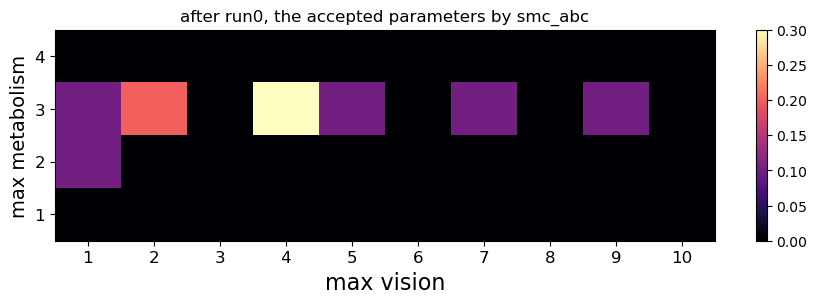

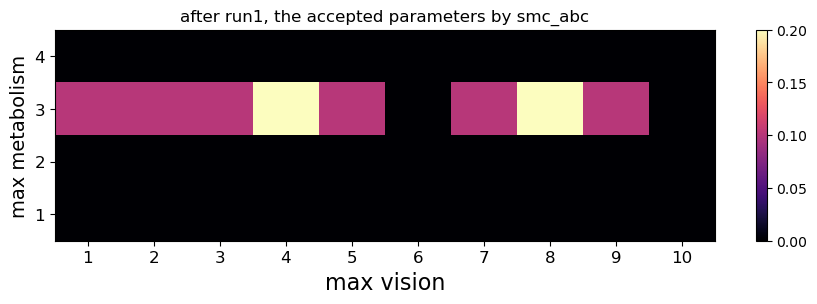

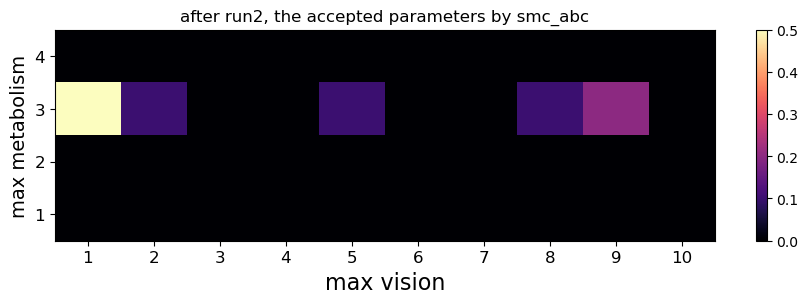

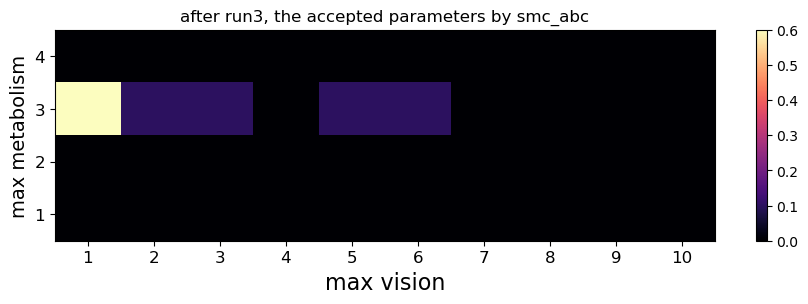

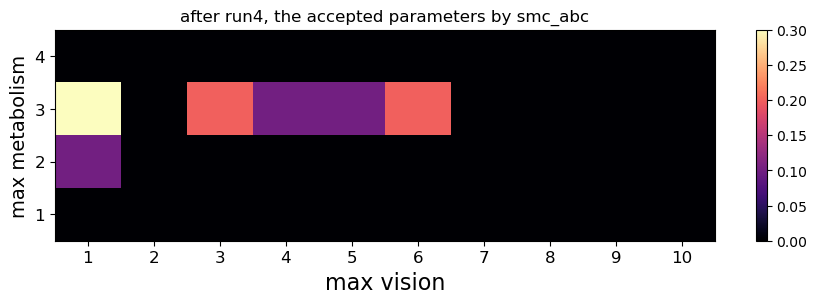

...

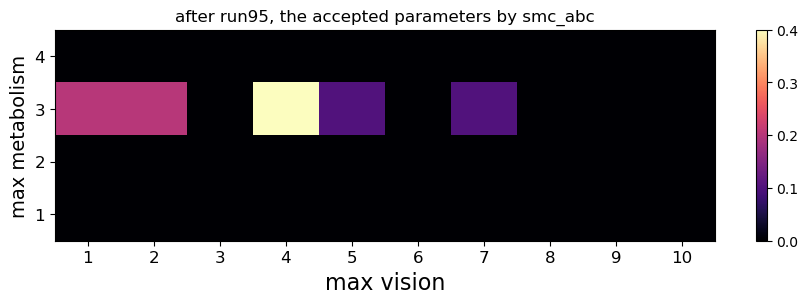

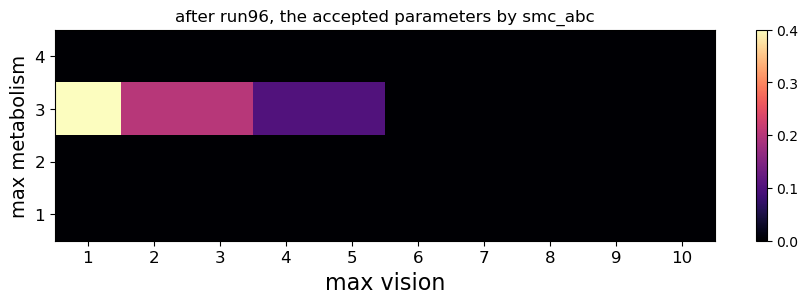

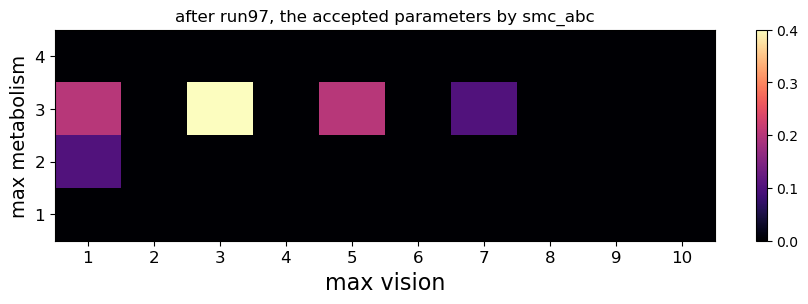

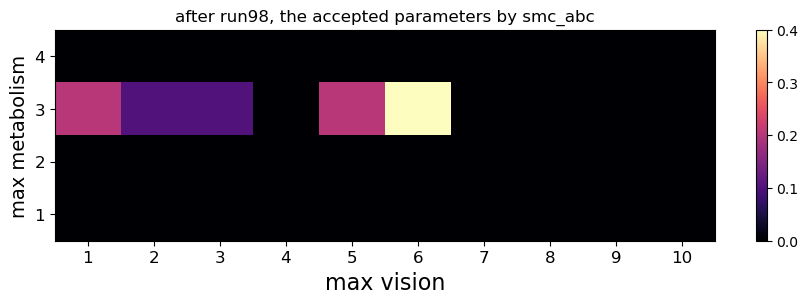

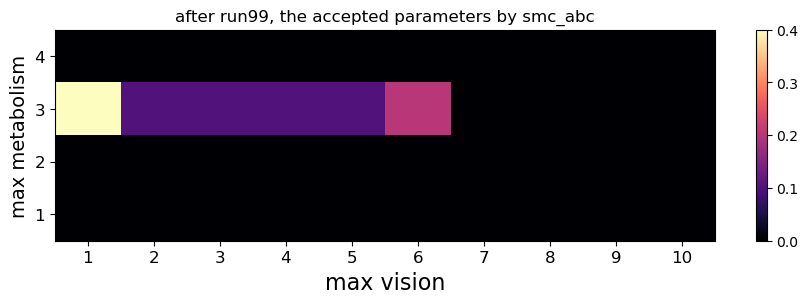

In [10]:
import math
T=100
N=10
init_w = [1/N]*N
initial_eps=10
kernel_gen = 'gaussian_component_wise'
adapt=True, 
alphas=[0.9]

for alpha in alphas:
    population_history, noise_population_history, weight_history, eps_history, time_history = smcabc(T, init_w, N, initial_eps=initial_eps, kernel_gen=kernel_gen, 
                                                                                    adapt=adapt, alpha=alpha)

    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
        pickle.dump(population_history, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/noise_parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
        pickle.dump(noise_population_history, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/weight_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
        pickle.dump(weight_history, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/eps_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
        pickle.dump(eps_history, fid)
    with open(f'E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/time_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
        pickle.dump(time_history, fid)

In [16]:
view = np.load('E:/Imperial 2023-24/project!!/sugarscape/abc_without_hm/smc_abc/obs78/adaptive/noise_parameter_history_T_100_N_10_initial_eps_10_gaussian_component_wise_adapt_(True,)_alpha_0.9.npy'
               ,allow_pickle=True)
view[-1,:]

array([array([3.93951691, 5.35573934]), array([3.03628116, 1.54884704]),
       array([3.99170274, 6.22192572]), array([3.47262986, 4.51220829]),
       array([3.03544905, 1.        ]), array([3.12762518, 1.        ]),
       array([3.4470341 , 3.59470559]), array([3.92994823, 6.0499408 ]),
       array([3.4273569 , 2.19043526]), array([3.30405671, 1.39442067])],
      dtype=object)

##### smc_abc + hm

In [32]:
from typing import Any, Callable, Dict, Optional, Tuple, Union

import numpy as np
np.random.seed(42)
import matplotlib.pyplot as plt 
import time
import torch
from numpy import ndarray
import random
from torch import Tensor, ones, tensor
from torch.distributions import Distribution, Multinomial, MultivariateNormal
import itertools 
from scipy.stats import norm

non_implausible_space = np.load('E:/project/non_implausible_space.npy', allow_pickle=True)
non_implausible_space = [r for r in non_implausible_space if r[1]<=10]

non_implausible_space # clip the vision to (1,10)

# for simplicty, remove (3,1) to ensure the meta parameter is only set as 4
# so that we only need to perform the perturbation kernel on the vision param

non_implausible_space = [r for r in non_implausible_space if r[0]==4]

aa = None
def smcabc_hm(T, init_w, N, initial_eps, kernel_gen:str, adapt:bool=False, alpha=None):
    """
        T: number of iterations
        N: number of samples each run t
        initial_eps: threshold for the first run, and for the rest if adapt=False
        kernel_gen: generator to specify the kernel used, a lot to discuss the optimality
        adapt: boolean value to determine whether alpha quantile is used for updating thershold
    """
    t = 0
    population_history = np.ndarray(shape=(T,N), dtype=object)
    noise_population_history = np.ndarray(shape=(T,N), dtype=object)

    weight_history = np.ndarray(shape=(T,N))
    weight_history[0,:] = [1/N]*N

    eps = initial_eps # fixed, unless adapt=true
    eps_history = [initial_eps]
    
    accept_history = np.array([[False]*N ]*T,dtype=object)
    time_history = np.ndarray(shape=(T,N))

    while t<T: # the termination criteria only depends on t
        # the simulation function only takes integer arguments as the resources are distributed on the int grid
        # apply linear interpolation to determine the final survival count: epochrun_float
        print(f'run{t}: \n')
        for _ in range(N):
            errors = []
            accept = False
            a = time.time()
            while accept!=True:
                if t==0: # initial data, namely noise_data
                    theta_from_weight = np.array([4, random.choice(range(1,11))]) # only select the vision parameter
                    noise_theta = theta_from_weight + np.array([0, np.random.normal(size=1).item()]) # do not change the meta 4
                    
                    population_history[t,_] = theta_from_weight
                    noise_population_history[t,_] = noise_theta
                else:
                    # sample θ from the previous population
                    #                     
                    theta_from_weight = np.random.choice(noise_population_history[t-1,:], size=1, p=weight_history[t-1,:])[0]
                    
                    # print('theta_from_weight 2:', theta_from_weight[0].shape, theta_from_weight)
                    # theta_from_weight = np.reshape(theta_from_weight, (2,)) 
                   
                    # add perturbation noise   
                    # initiate the kernel for generation purpose           
                    if kernel_gen == 'gaussian':
                        std_t = 1 if t==1 else np.cov([r[1] for r in noise_population_history[t-1,:]])
                        print('std_t for parameter vision:', std_t)
                        # here theta_time_t is regarded at the mean of guassian generator
                        perturbation = np.array([0, np.random.normal(loc=0, scale=std_t)])
                        perturbation = np.reshape(perturbation, (2,))
                        a2 = [round(r, 4) for r in perturbation]
                        print(f'perturbation:', a2)

                        noise_theta = perturbation/(std_t)  + theta_from_weight
                        
                    elif kernel_gen == 'uniform':
                        theta_tminus = noise_population_history[t-1,:]
                        std_t =  0.5 * (max([theta_tminus[k][1] for k in range(N)]) -
                                        min([theta_tminus[k][1] for k in range(N)]) )
                        noise_theta = np.array([4, np.random.uniform(low = theta_from_weight[1] - std_t, high = theta_from_weight[1] + std_t, size=1).item()])
                
                a1 = [round(r, 4) for r in theta_from_weight]
                print(f'theta t:', a1 )
                
                # preprocess the noise theta, make sure it is valid in the range [4,10]
                noise_theta[1] = noise_theta[1] % 10
                noise_theta[1] = np.clip(noise_theta[1], 1,10).item()
                print('noise theta', noise_theta ) # in hm setting, expect (4,?) format
                # print(noise_theta)

                # run simulations from the noise theta\
                sim = epochrun_float(100, 100, 4, noise_theta[0], noise_theta[1]) # summary statistics, scalar
                print('simulation', sim)
                dis = error(sim)
                
                if dis<eps:
                    accept = True
                    accept_history[t,_] = True

            b = time.time()
            time_taken = b - a
            time_history[t,_] = time_taken

            print(f'run{t}, i={_}, time = {time_taken:.4f}, theta from weight={theta_from_weight}, perturbed param is:{noise_theta}, accepted!')
            # update the param history until theta accepted
            population_history[t,_] = theta_from_weight # add tuple because the original input is array
            noise_population_history[t,_] = noise_theta
            errors.append(dis)

        print(f'after run{t}, the accepted parameters are: {noise_population_history[t,:]} \n')
        
        # plot the snapshot of accepted parameters at time t
        plot_results(noise_population_history[t,:])
        plt.title(f'after run{t}, the accepted parameters by smc_abc')

        # update the eps if adapt=true
        if adapt==True:
            eps = np.quantile(errors, q=alpha) # across N errors
        eps_history.append(eps)

        # update importance weight_history
        # r stands for the new accepted thetas (length N) in time t
        def kernel_density(std, theta, x):
            """
            std: scalar, standard deviation for vision parameter in theta
            """
            return math.exp(-(theta-x)**2 / (2*std*std))/(2*math.pi*std)
        
        weight_new = [0]*N
        for i, r in enumerate(noise_population_history[t,:]): # r is theta_(i,t)
            if t==0: std_t = 1
            vec_kernel_density = [kernel_density(std_t, noise_population_history[t,j][1], r[1]) for j in range(N)]
            weight_new[i] = (1/N) / np.dot(weight_history[t-1,:], vec_kernel_density)
        
        # normalization of prob to 1
        w_sum = sum(weight_new)
        weight_new = [r/w_sum for r in weight_new] 

        t += 1
        if t!=1 and t<T: # except for the initial uniform weight
            weight_history[t-1,:] = weight_new
        
    return population_history, noise_population_history, weight_history, eps_history, time_history



run0: 

theta t: [np.int64(4), np.int64(7)]
noise theta [4.         4.39044956]
simulation 73.87640354426495
run0, i=0, time = 0.5933, theta from weight=[4 7], perturbed param is:[4.         4.39044956], accepted!
theta t: [np.int64(4), np.int64(9)]
noise theta [4.         8.36147955]
simulation 82.19260224314152
run0, i=1, time = 0.6110, theta from weight=[4 9], perturbed param is:[4.         8.36147955], accepted!
theta t: [np.int64(4), np.int64(3)]
noise theta [4.         3.66622574]
simulation 76.99735443434297
run0, i=2, time = 0.5696, theta from weight=[4 3], perturbed param is:[4.         3.66622574], accepted!
theta t: [np.int64(4), np.int64(6)]
noise theta [4.         5.72505574]
simulation 76.72505574129596
run0, i=3, time = 0.5901, theta from weight=[4 6], perturbed param is:[4.         5.72505574], accepted!
theta t: [np.int64(4), np.int64(3)]
noise theta [4.         1.49093003]
simulation 70.38209038845989
run0, i=4, time = 0.5278, theta from weight=[4 3], perturbed param 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21708\3846231422.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 1, figsize=(9, 3))


simulation 75.69549071502857
run21, i=0, time = 0.6922, theta from weight=[4.         5.13042236], perturbed param is:[4.         5.13042236], accepted!
theta t: [np.float64(4.0), np.float64(5.1304)]
noise theta [4.         5.13042236]
simulation 79.39126708808351
run21, i=1, time = 0.6414, theta from weight=[4.         5.13042236], perturbed param is:[4.         5.13042236], accepted!
theta t: [np.float64(4.0), np.float64(5.1304)]
noise theta [4.         5.13042236]
simulation 73.39126708808351
run21, i=2, time = 0.5869, theta from weight=[4.         5.13042236], perturbed param is:[4.         5.13042236], accepted!
theta t: [np.float64(4.0), np.float64(5.1304)]
noise theta [4.         5.13042236]
simulation 80.260844725389
run21, i=3, time = 0.5862, theta from weight=[4.         5.13042236], perturbed param is:[4.         5.13042236], accepted!
theta t: [np.float64(4.0), np.float64(5.1304)]
noise theta [4.         5.13042236]
simulation 78.30422362694505
run21, i=4, time = 0.5970, th

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21708\1323239803.py:140: RuntimeWarning: overflow encountered in scalar divide
  weight_new[i] = (1/N) / np.dot(weight_history[t-1,:], vec_kernel_density)
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21708\1323239803.py:143: RuntimeWarning: invalid value encountered in scalar add
  w_sum = sum(weight_new)


simulation 79.46486135872917
run1, i=0, time = 0.5692, theta from weight=[4.         4.91873309], perturbed param is:[4.        4.3849846], accepted!
std_t for parameter vision: 1
perturbation: [np.float64(0.0), np.float64(-0.188)]
theta t: [np.float64(4.0), np.float64(1.0)]
noise theta [4. 1.]
simulation 64
std_t for parameter vision: 1
perturbation: [np.float64(0.0), np.float64(0.5769)]
theta t: [np.float64(4.0), np.float64(8.524)]
noise theta [4.         9.10088076]
simulation 84.0
run1, i=1, time = 0.8659, theta from weight=[4.         8.52395978], perturbed param is:[4.         9.10088076], accepted!
std_t for parameter vision: 1
perturbation: [np.float64(0.0), np.float64(-0.9811)]
theta t: [np.float64(4.0), np.float64(1.0)]
noise theta [4. 1.]
simulation 58
std_t for parameter vision: 1
perturbation: [np.float64(0.0), np.float64(-1.3698)]
theta t: [np.float64(4.0), np.float64(3.6136)]
noise theta [4.         2.24371508]
simulation 72.75628491685698
run1, i=2, time = 0.7584, theta

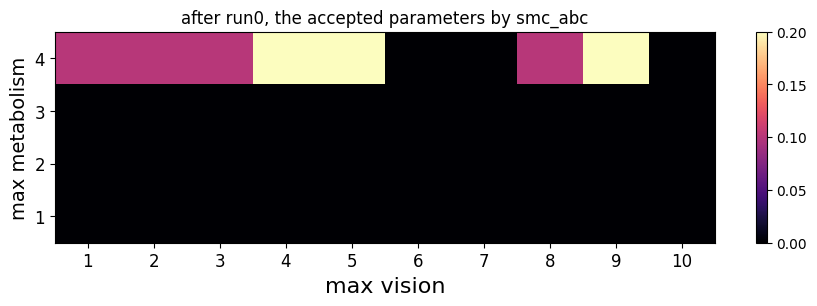

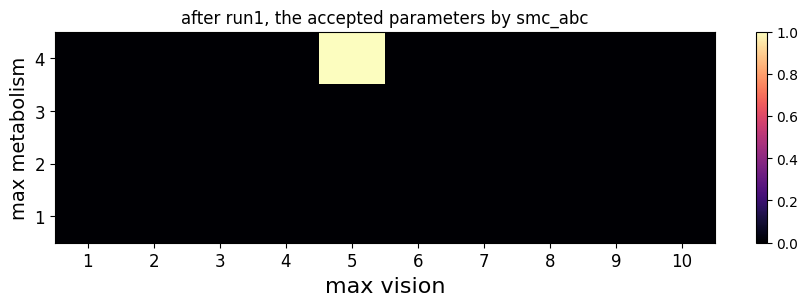

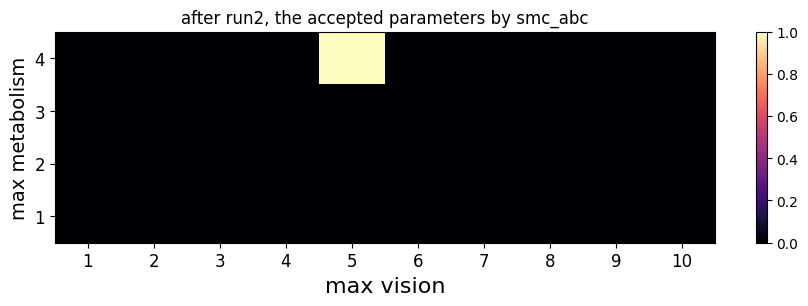

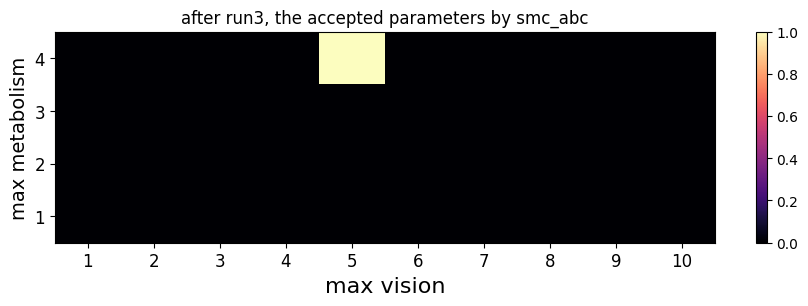

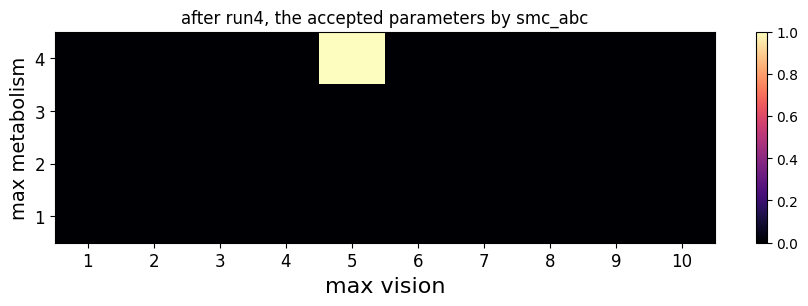

...

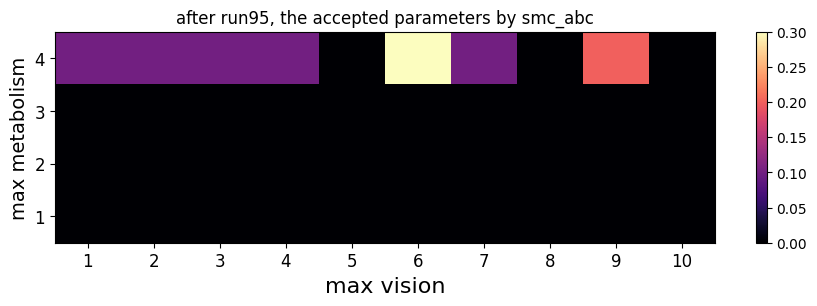

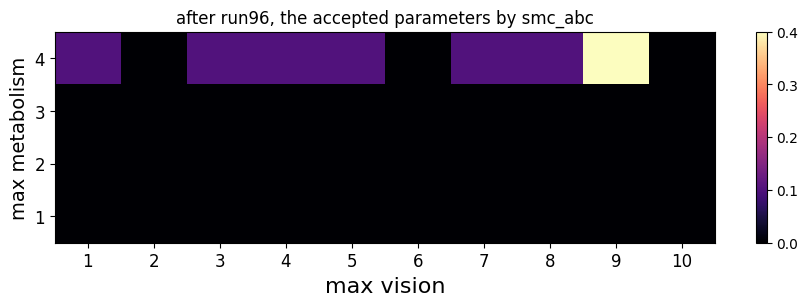

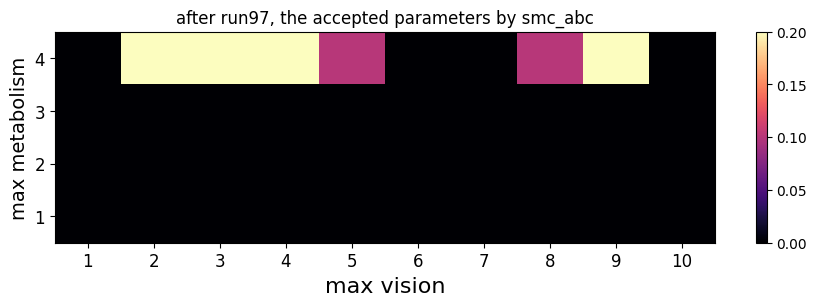

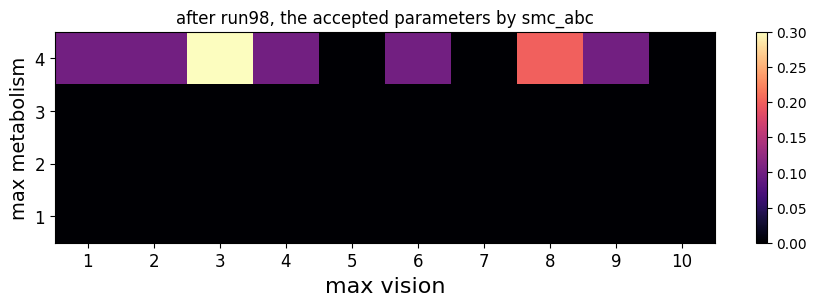

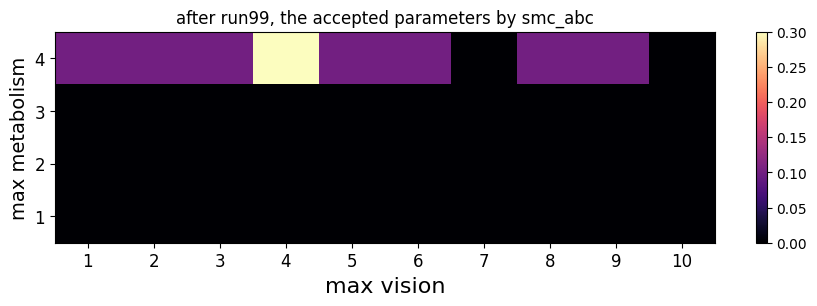

In [34]:
T=100
N=10
init_w = [1/N]*N
initial_eps=10
kernel_gen_ls = ['adapt', 'gaussian']
adapt=True, 
alphas =[0.5, 0.9]

for kernel_gen in kernel_gen_ls:
    for alpha in alphas:
        population_history, noise_population_history, weight_history, eps_history, time_history = smcabc_hm(T, init_w, N, initial_eps=initial_eps, kernel_gen=kernel_gen, 
                                                                                        adapt=adapt, alpha=alpha)

        with open(f'E:/project/smc_abc_hm/adapt/parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
            pickle.dump(population_history, fid)
        with open(f'E:/project/smc_abc_hm/adapt/noise_parameter_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
            pickle.dump(noise_population_history, fid)
        with open(f'E:/project/smc_abc_hm/adapt/weight_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
            pickle.dump(weight_h  istory, fid)
        with open(f'E:/project/smc_abc_hm/adapt/eps_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
            pickle.dump(eps_history, fid)
        with open(f'E:/project/smc_abc_hm/adapt/time_history_T_{T}_N_{N}_initial_eps_{initial_eps}_{kernel_gen}_adapt_{adapt}_alpha_{alpha}.npy', 'wb') as fid:
            pickle.dump(time_history, fid)

#### Simulated Annealing (SA): Another calibration method: point estimation, continuous, 

In [122]:
import numpy as np
import random
import math
import matplotlib.pyplot as plt
import time
import itertools

obs = 78

# Objective function (to minimize)
def objective_function(x:np.array):
    summary = epochrun(100, 100, 4, x[0], x[1])[-1] # the final survival count generated by sample x
    return abs(summary - obs) ** 0.5

# Simulated annealing algorithm for the full space

def simulated_annealing(objective_function, initial_solution, max_iterations, initial_temp, cooling_rate):
    # Initialize current solution
    current_solution = initial_solution
    current_value = objective_function(current_solution)
    
    # Track the best solution
    best_solution = current_solution
    best_value = current_value
    
    # Set initial temperature
    temperature = initial_temp
    
    # History of solutions for visualization
    solution_history = [current_solution]
    value_history = [current_value]

    # Main loop for the SA process
    a = time.time()
    for iteration in range(max_iterations):
        # Generate a neighboring solution (small perturbation)

        # x1, x2 = 0, 0 
        # if np.allclose(current_solution, [3,9]):
        #     x1, x2 = np.random.randint(2,5) , np.random.randint(2, 11) # in this case, meta can add {2,3,4} and vision can add {2, 3, ... ,10}
        # elif current_solution[0]==4 or current_solution[1]==10:
        #     x1, x2 = np.random.randint(0,4) , np.random.randint(0,10) 
        # else:
        #     while x1+x2 ==0:
        #         x1, x2 = np.random.randint(0,4-current_solution[0]) , np.random.randint(0,10-current_solution[1]) 
        # perturb = np.array([x1, x2])
        # print('perturb', perturb)

        perturb = np.random.randint(0, 10, size=2)

        neighbor_solution = current_solution + perturb # Slight random change
        neighbor_solution = np.array([1 + neighbor_solution[0] % 4, 1 + neighbor_solution[1] % 10])
        # print('perturb value is:', perturb, 'neighbour solution is:', neighbor_solution)
        neighbor_value = objective_function(neighbor_solution)
        
        # Calculate the acceptance probability
        delta_value = neighbor_value - current_value
        # print('delta value:', delta_value)
        acceptance_probability = math.exp(-delta_value / temperature) if delta_value > 0 else 1.0
        
        # Decide whether to move to the neighbor solution
        if random.uniform(0, 1) < acceptance_probability:
            current_solution = neighbor_solution
            current_value = neighbor_value
        
        # Update the best solution
        if current_value < best_value:
            best_solution = current_solution
            best_value = current_value
        
        # Cool down the temperature
        temperature *= cooling_rate
        
        # Store the solution and value for visualization
        solution_history.append(current_solution)
        value_history.append(current_value)
        
        # Optionally print the current status
        if iteration % 100 == 0:
            print(f"Iteration {iteration}: Current Solution = {current_solution}, Best Value = {best_value}")
    b = time.time()
    timetaken = b -a 
    return best_solution, best_value, solution_history, value_history, timetaken

# Parameters
space = [r for r in itertools.product(range(1,5), range(1,11,1))]
n = len(space)
np.random.seed(43)

initial_solutions = [space[r] for r in np.random.randint(0, n, size=5)] 
max_iterations = 500
initial_temp = 10  # Initial temperature (higher allows more exploration)
cooling_rate = 0.99  # Cooling rate (how fast temperature decreases)

params = [r for r in itertools.product([10,50], [0.95, 0.99])]
# Run simulated annealing
#for initial_solution in initial_solutions:
    #for i, param in enumerate(params):
        #initial_temp, cooling_rate = param
best_solution, best_value, solution_history, value_history, time_taken = simulated_annealing(objective_function, initial_solution, max_iterations, initial_temp, cooling_rate)

with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing/SA_solution_history_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
    pickle.dump(solution_history, fid)
    
with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing/SA_value_history_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
    pickle.dump(value_history, fid)

with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing/SA_runningtimes_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
    pickle.dump(time_taken, fid)

print(f"initial: {initial_solution}, Best Solution: {best_solution}, Best Value: {best_value}")


KeyboardInterrupt: 

##### define functions to fetch all files with certain suffix.

In [5]:
from pathlib import Path
import os

def getFileName1(path,suffix): 
    # retrieve all files ending with certain suffix, in the given directory
    input_template_All=[]
    f_list = os.listdir(path) # return the file name
    for i in f_list:
        # os.path.splitext(): split the file name and suffix name
        if os.path.splitext(i)[1] ==suffix:
            input_template_All.append(i)
            #print(i)
    return input_template_All

def getFileName2(path,suffix):
    input_template_All=[]
    input_template_All_Path=[]
    for root, dirs, files in os.walk(path, topdown=False):
         for name in files:
             #print(os.path.join(root, name))
             # print(name)
             if os.path.splitext(name)[1] == suffix:
                 input_template_All.append(name)
                 input_template_All_Path.append(os.path.join(root, name))
        
    return input_template_All,input_template_All_Path

# path='E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm'

# input_template_All1=getFileName1(path,'.npy')
# input_template_All2,input_template_All_Path2=getFileName2(path,'.npy')


In [16]:
root = 'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing/'

input_template_All2,input_template_All_Path2=getFileName2(root,'.npy') 
solution_files = [str(r) for r in input_template_All_Path2 if str(r).__contains__('SA_solution')]
print('1',len(solution_files))
solution_collect = {k: [np.load(r, allow_pickle=True)[-1] for r in solution_files if r.__contains__(str(k))] for k in initial_solutions}
solution_collect


1 16


{(1, 5): [array([4, 5]), array([4, 7]), array([4, 7]), array([4, 6])],
 (1, 1): [array([4, 7]), array([4, 7]), array([4, 5]), array([4, 3])],
 (3, 2): [array([4, 5]), array([4, 5]), array([4, 3]), array([4, 5])],
 (2, 7): [array([4, 4]), array([4, 5]), array([3, 1]), array([4, 5])],
 (2, 8): []}

**The results above demonstrates that, travelling through the full parameter space doesn't effectively reflect the high probable region around (4,6). It might be worthwhile trying running SA on the non-implausible space after HM.**

In [3]:
import random , math
import matplotlib.pyplot as plt
import time 

non_implausible_space = np.load('./non_implausible_space.npy', allow_pickle=True)
reduce_non_implausible_space = [r for r in non_implausible_space if r[1]<=10 and r[0]!=3]

def objective_function(x:np.array):
    summary = epochrun(100, 100, 4, x[0], x[1])[-1] # the final survival count generated by sample x
    return abs(summary - obs) ** 0.5

def simulated_annealing_hm(objective_function, initial_solution, max_iterations, initial_temp, cooling_rate):
    # Initialize current solution
    current_solution = initial_solution
    current_value = objective_function(current_solution)
    
    # Track the best solution
    best_solution = current_solution
    best_value = current_value
    
    # Set initial temperature
    temperature = initial_temp
    
    # History of solutions for visualization
    solution_history = [current_solution]
    value_history = [current_value]
   
    times = []
    # Main loop for the SA process
    for iteration in range(max_iterations):
        if iteration % 100 ==0:
            a = time.time()

        # Generate a neighboring solution (small perturbation)

        # x1, x2 = 0, 0 
        # if np.allclose(current_solution, [3,9]):
        #     x1, x2 = np.random.randint(2,5) , np.random.randint(2, 11) # in this case, meta can add {2,3,4} and vision can add {2, 3, ... ,10}
        # elif current_solution[0]==4 or current_solution[1]==10:
        #     x1, x2 = np.random.randint(0,4) , np.random.randint(0,10) 
        # else:
        #     while x1+x2 ==0:
        #         x1, x2 = np.random.randint(0,4-current_solution[0]) , np.random.randint(0,10-current_solution[1]) 
        # perturb = np.array([x1, x2])
        # print('perturb', perturb)

        
        neighbor_solution = random.choice(non_implausible_space)

        ## print('neighbour solution is:', neighbor_solution)
        neighbor_value = objective_function(neighbor_solution)
        
        # Calculate the acceptance probability
        delta_value = neighbor_value - current_value
        ## print('delta value:', delta_value)
        acceptance_probability = math.exp(-delta_value / temperature) if delta_value > 0 else 1.0
        
        # Decide whether to move to the neighbor solution
        if random.uniform(0, 1) < acceptance_probability:
            current_solution = neighbor_solution
            current_value = neighbor_value
        
        # Update the best solution
        if current_value < best_value:
            best_solution = current_solution
            best_value = current_value
        
        # Cool down the temperature
        temperature *= cooling_rate

        # Store the solution and value for visualization
        solution_history.append(current_solution)
        value_history.append(current_value)
        # Optionally print the current status
        if iteration % 100 == 0:
            print(f"Iteration {iteration} done: Current Solution = {current_solution}, Best Value = {best_value}")
     
        if iteration % 100 == 99:
            b = time.time()
            times.append(b-a)
        
    return best_solution, best_value, solution_history, value_history, times

# Parameters
n = len(reduce_non_implausible_space)
obs = 78
max_iterations = 500
initial_temp = 10  # Initial temperature (higher allows more exploration)
cooling_rate = 0.99  # Cooling rate (how fast temperature decreases)

# Run simulated annealing
for initial_solution in reduce_non_implausible_space:
    for cooling_rate in [0.9, 0.95, 0.99]:
        print(f'initial solution: {initial_solution}, initial_temp: {initial_temp}, obs={obs}. cooling_rate:{cooling_rate}')
        best_solution, best_value, solution_history, value_history, time_taken = simulated_annealing_hm(objective_function, initial_solution, max_iterations, initial_temp, cooling_rate)

        with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500/SA_solution_history_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
            pickle.dump(solution_history, fid)
            
        with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500/SA_value_history_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
            pickle.dump(value_history, fid)
        
        with open(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500/SA_runningtimes_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.npy', 'wb') as fid:
            pickle.dump(time_taken, fid)

        print(f"Best Solution: {best_solution}, Best Value: {best_value}")

        # Plotting the solution history
        yticks = range(1,6)
        xticks = range(1, 18)
        
        plot_results(solution_history)
        print(f'finish run with {initial_temp}, {cooling_rate}')
        plt.savefig(f'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500/SA_solution_history_iteration_{max_iterations}_initial_{initial_solution}_obs_{obs}_temp_{initial_temp}_coolrate_{cooling_rate}.jpg')

initial solution: (4, 1), initial_temp: 10, obs=78. cooling_rate:0.9
Iteration 0 done: Current Solution = (4, 7), Best Value = 1.7320508075688772


: 

In [6]:
# locs is the list of npy files whose corresponding 2d plot (jpg file) shows high probable regions at (4,6)
locs = ['E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(3, 1)_obs_81_temp_5_coolrate_0.2.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(3, 1)_obs_80_temp_5_coolrate_0.5.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(3, 1)_obs_79_temp_5_coolrate_0.8.npy',	

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(3, 1)_obs_78_temp_5_coolrate_0.8.npy',


'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 1)_obs_78_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 2)_obs_78_temp_5_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 2)_obs_78_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 2)_obs_81_temp_5_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 5)_obs_79_temp_5_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 6)_obs_78_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 6)_obs_81_temp_5_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 7)_obs_66_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 7)_obs_81_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 9)_obs_80_temp_5_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 9)_obs_80_temp_10_coolrate_0.99.npy',

'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/SA_solution_history_iteration_100_initial_(4, 10)_obs_80_temp_10_coolrate_0.99.npy'
]

# collect the best solution from the distribution 
# technically we only care about the point estimation following SA
best_sols = [np.load(r, allow_pickle=True)[-1] for r in locs]
pd.Series(best_sols).value_counts()

(4, 6)     5
(4, 3)     2
(4, 5)     2
(4, 4)     2
(4, 1)     1
(4, 7)     1
(4, 12)    1
(4, 2)     1
(4, 9)     1
Name: count, dtype: int64

**The summary above shows, regardless of the initial solution & observation choice, 33% SA recognizes (4,6). We here create a dict to show the stability**

##### calculate the average running time for SA

In [43]:
path = 'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500'
input_template_All1=getFileName1(path,'.npy')

input_template_All2,input_template_All_Path2=getFileName2(path,'.npy') 
time_collect = [str(r) for r in input_template_All2 if str(r).__contains__('SA_runningtimes')]

mean_times_statistics = {}
for r in reduce_non_implausible_space:
    runtimes = [np.mean(np.load( path+'/'+k , allow_pickle=True)) for k in time_collect if k.__contains__(f'{r}')]
    mean_times_statistics[r] = runtimes
    print(f'initial_solution:{r} with cooling rates have running times {runtimes}')

with open('E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500/mean_runtimes.npy', 'wb') as fid:
    pickle.dump(runtimes, fid)

initial_solution:(4, 1) with cooling rates have running times [264.92937326431274, 260.9102189540863, 261.5671833992004]
initial_solution:(4, 2) with cooling rates have running times [258.4637311458588, 248.13770661354064, 241.20783548355104]
initial_solution:(4, 3) with cooling rates have running times [241.90276718139648, 241.50784010887145, 250.85008058547973]
initial_solution:(4, 4) with cooling rates have running times [257.2029146194458, 256.14896235466006, 256.70564460754395]
initial_solution:(4, 5) with cooling rates have running times [254.56555199623108, 256.40251183509827, 258.5157911300659]
initial_solution:(4, 6) with cooling rates have running times [258.62503600120544, 251.6039072036743, 243.77593464851378]
initial_solution:(4, 7) with cooling rates have running times [234.05483179092408, 159.82696838378905, 211.4250867843628]
initial_solution:(4, 8) with cooling rates have running times [243.87415924072266, 243.68524260520934, 242.13720879554748]
initial_solution:(4, 9)

##### summarize the solution_history: plot the distribution of best_solutions (i.e as point estimation for SA}, we notice that SA fails in allocating a high posterior at (meta, vision) = (4,6) regardless of the initial solution choice

In [65]:
path = 'E:/Imperial 2023-24/project!!/sugarscape/sim_annealing_hm/run2 iter=500'
# convert to string format
solution_collect = [str(r) for r in input_template_All2 if str(r).__contains__('SA_solution_history')]

# load the best solutions
all_best_sols = [np.load( path+'/'+str(r), allow_pickle=True)[-1] for r in solution_collect]
all_best_sols

# load the solutions across observations

obs=78    
for init in reduce_non_implausible_space:
    solution_collect_obs = [r for r in solution_collect if r.__contains__(f'initial_{init}')]
    best_sols_obs = [np.load( path+'/'+r, allow_pickle=True)[-1] for r in solution_collect_obs]
    print(f'Solution history shows the best SA point estimation starting at {init} are:', best_sols_obs)
    # plot_results(best_sols_obs)
    # plt.title(f'SA, obs={obs}')

Solution history shows the best SA point estimation starting at (4, 1) are: [(4, 7), (4, 5), (4, 5)]
Solution history shows the best SA point estimation starting at (4, 2) are: [(4, 9), (4, 4), (4, 5)]
Solution history shows the best SA point estimation starting at (4, 3) are: [(4, 5), (4, 4), (4, 8)]
Solution history shows the best SA point estimation starting at (4, 4) are: [(4, 4), (4, 6), (4, 6)]
Solution history shows the best SA point estimation starting at (4, 5) are: [(4, 9), (4, 11), (4, 7)]
Solution history shows the best SA point estimation starting at (4, 6) are: [(4, 6), (4, 5), (4, 3)]
Solution history shows the best SA point estimation starting at (4, 7) are: [(4, 8), (4, 3), (3, 1)]
Solution history shows the best SA point estimation starting at (4, 8) are: [(4, 6), (4, 4), (4, 7)]
Solution history shows the best SA point estimation starting at (4, 9) are: [(4, 6), (4, 5), (4, 4)]
Solution history shows the best SA point estimation starting at (4, 10) are: [(4, 9), (4, 

d:\aps\anaconda\envs\tf\lib\site-packages\numpy\lib\histograms.py:1067: RuntimeWarning: invalid value encountered in divide
  hist /= s
d:\aps\anaconda\envs\tf\lib\site-packages\numpy\lib\histograms.py:1067: RuntimeWarning: invalid value encountered in divide
  hist /= s
d:\aps\anaconda\envs\tf\lib\site-packages\numpy\lib\histograms.py:1067: RuntimeWarning: invalid value encountered in divide
  hist /= s
d:\aps\anaconda\envs\tf\lib\site-packages\numpy\lib\histograms.py:1067: RuntimeWarning: invalid value encountered in divide
  hist /= s


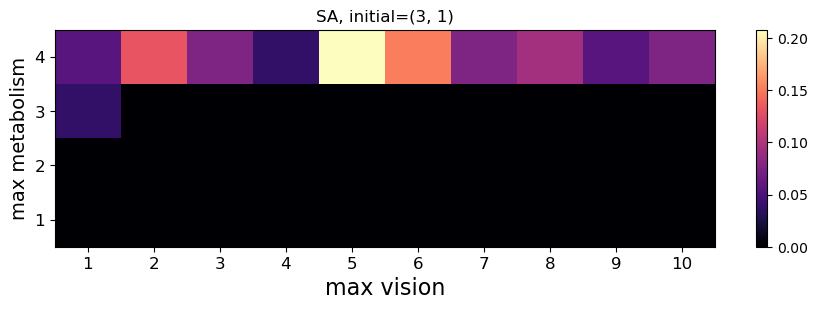

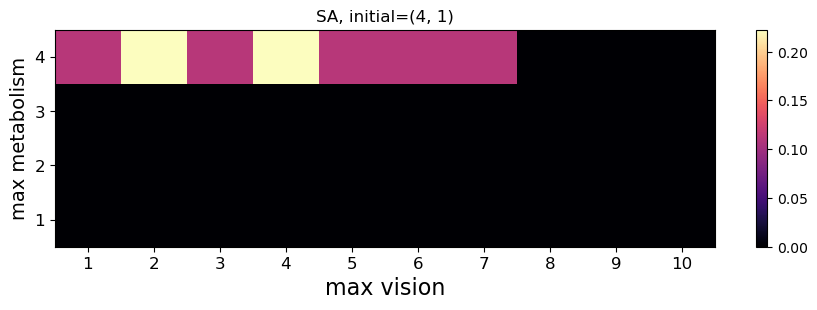

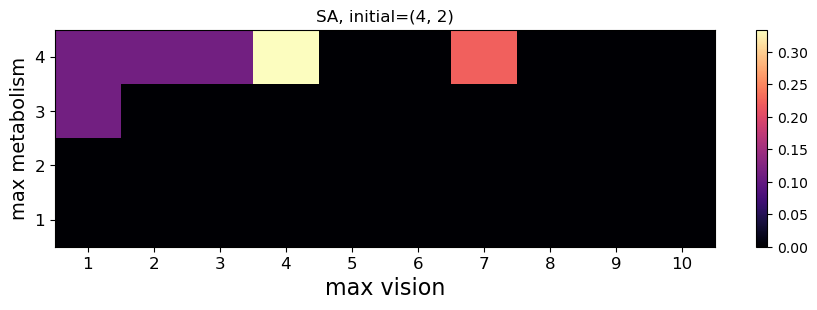

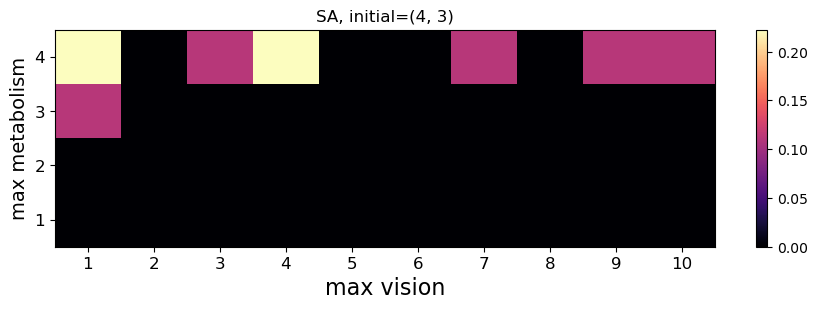

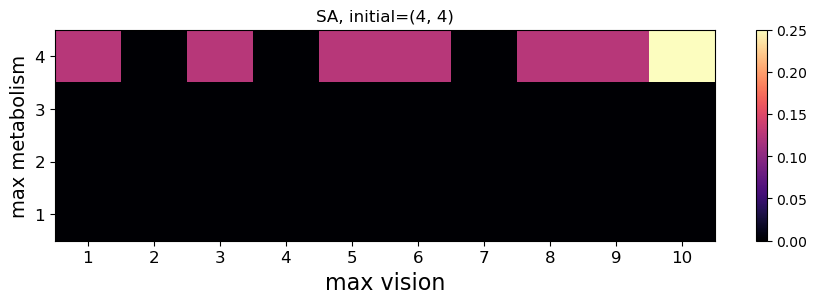

...

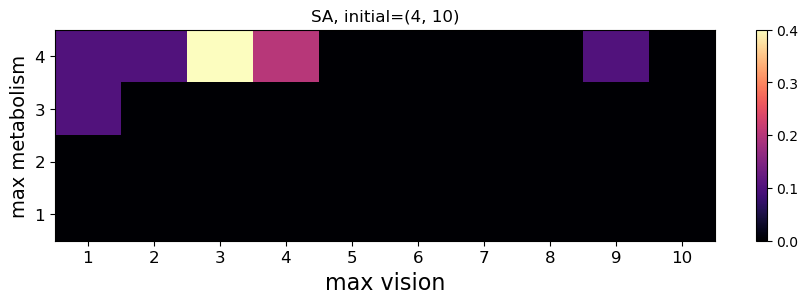

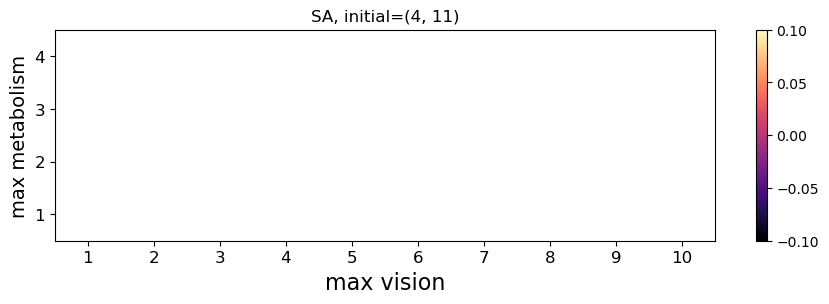

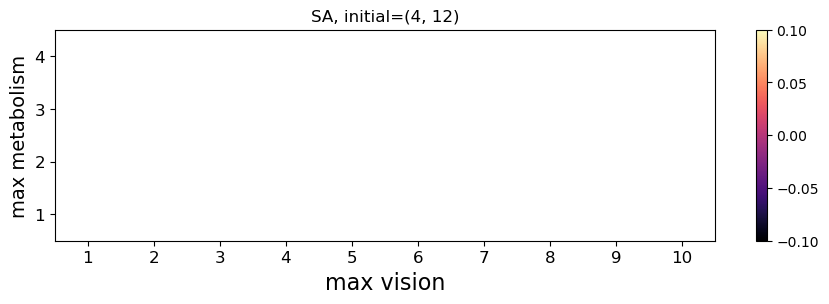

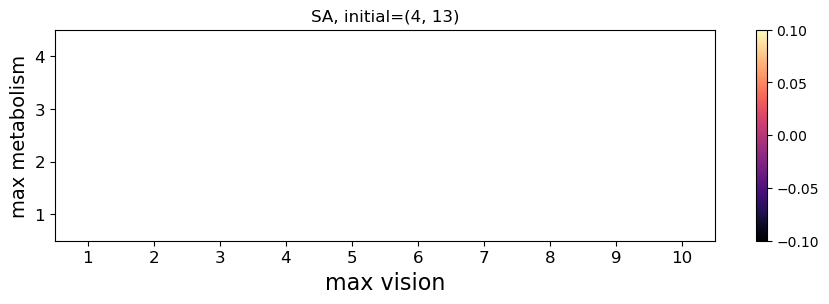

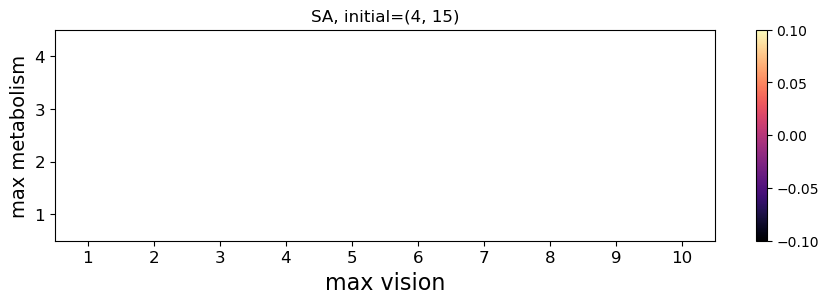

In [10]:
import random , math
import matplotlib.pyplot as plt

non_implausible_space = np.load('./non_implausible_space.npy', allow_pickle=True)
reduce_non_implausible_space = [r for r in non_implausible_space if r[1]<=10 and r[0]!=3]

for k in non_implausible_space:
    solution_ip_init_at_k = [root+'/'+r for r in solution_collect if r.__contains__(f'initial_{k}')]
    best_solution_init_at_k = [np.load(k, allow_pickle=True)[-1] for k in solution_ip_init_at_k]
    plot_results(best_solution_init_at_k)
    plt.title(f'SA, initial={k}')

##### summarize the value history for SA

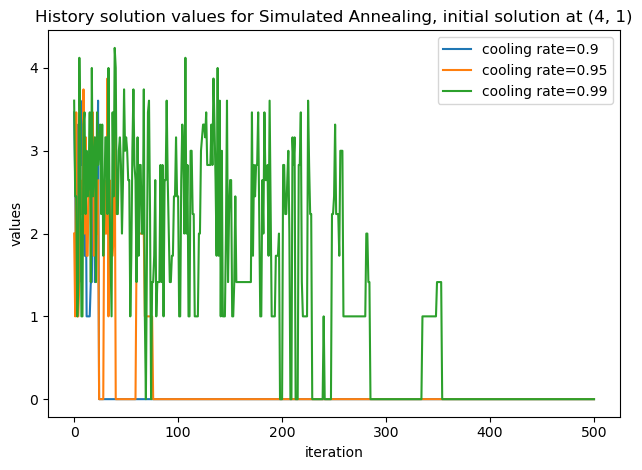

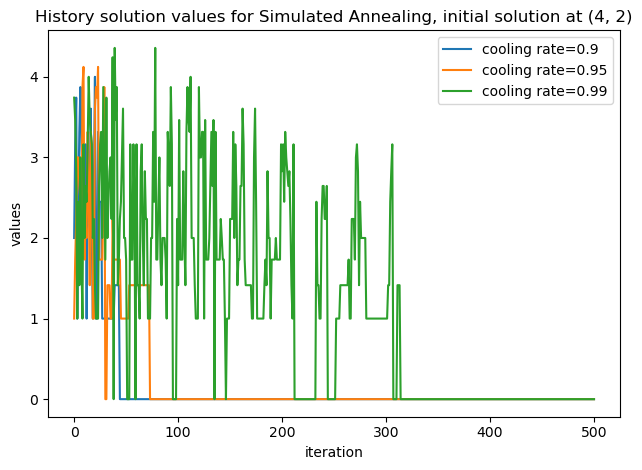

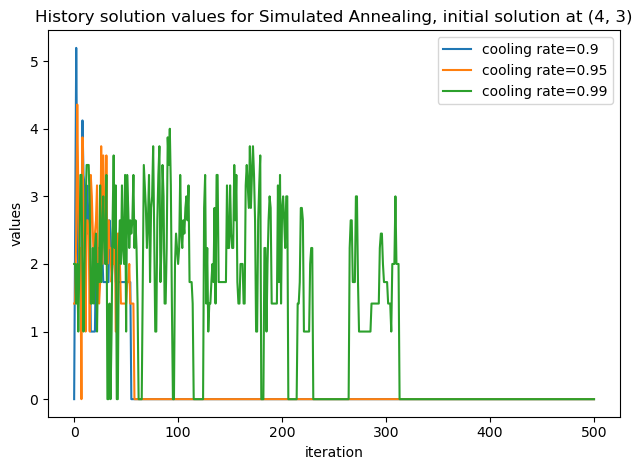

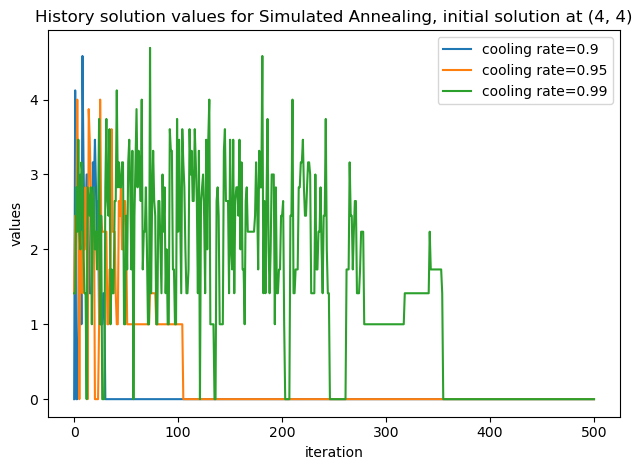

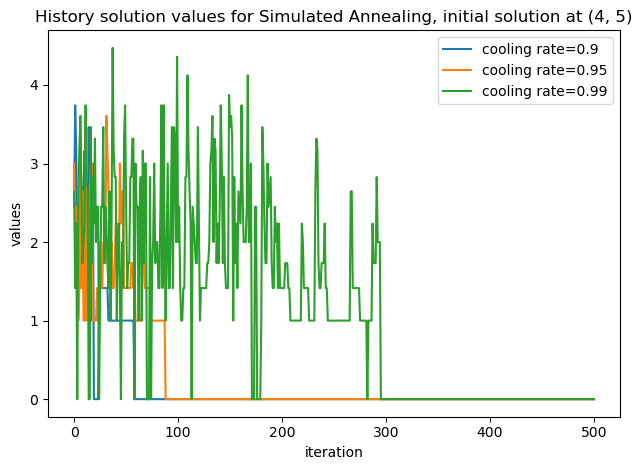

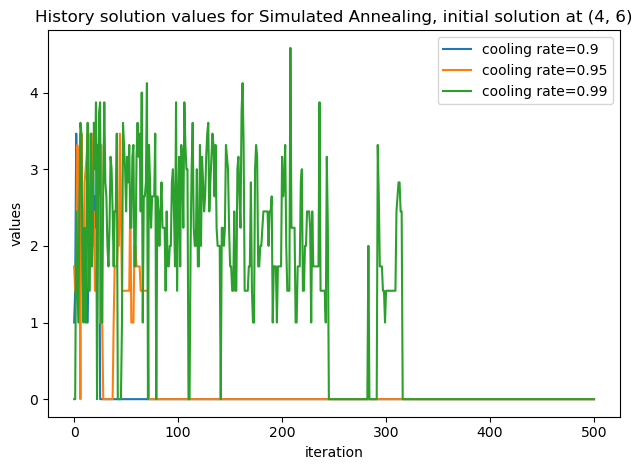

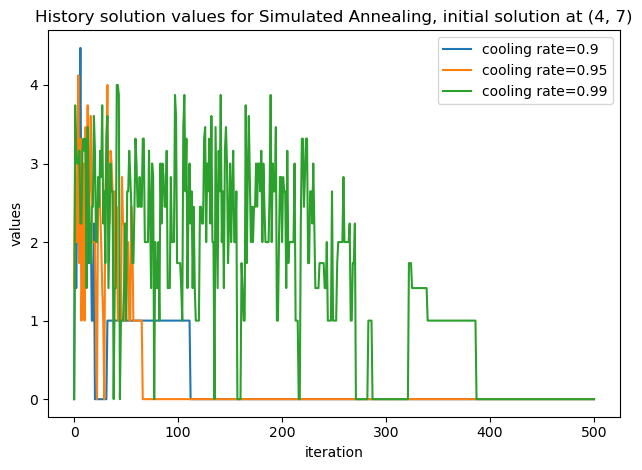

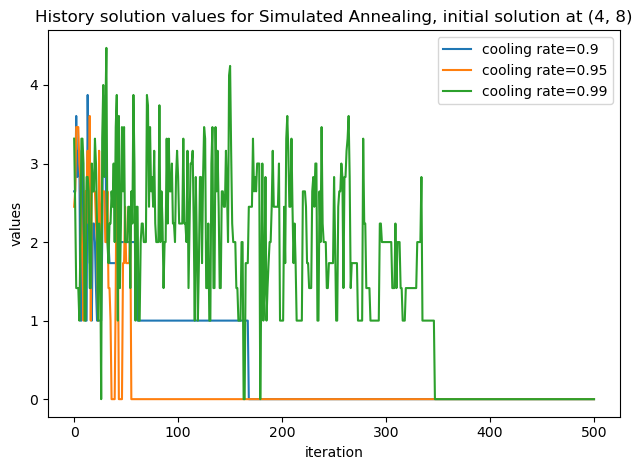

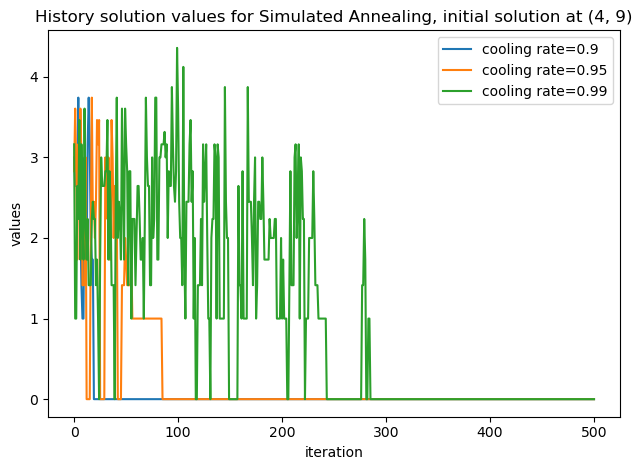

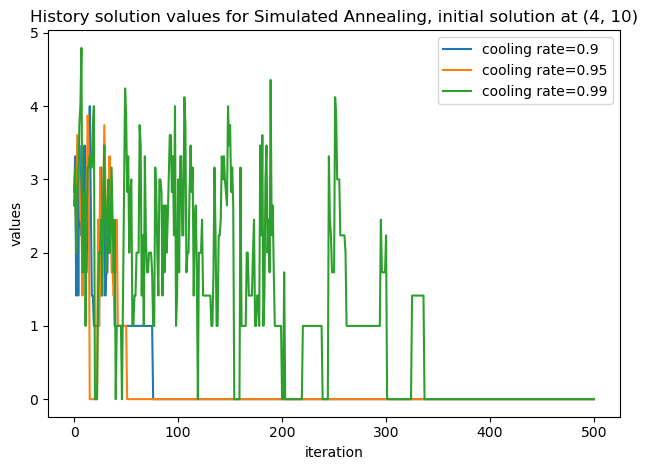

In [53]:
value_collect = [str(r) for r in input_template_All_Path2 if str(r).__contains__('value_history')] # full dire for each file

# plot the changes for each initial solution choice
for r in reduce_non_implausible_space:
    # fetch the value_history files
    values = [np.load(k, allow_pickle=True) for k in value_collect if k.__contains__(f'{r}')] # list of size 3
    values = np.array(values)
    
    with open(path+'/'+f'History solution values for Simulated Annealing, initial solution at {r}.npy', 'wb') as fid:
        pickle.dump(values, fid)

    plt.figure()
    plt.xlabel('iteration')
    plt.ylabel('values')
    plt.plot(values[0,:], label='cooling rate=0.9')
    plt.plot(values[1,:], label='cooling rate=0.95')
    plt.plot(values[2,:], label='cooling rate=0.99')
    plt.legend()
    plt.title(f'History solution values for Simulated Annealing, initial solution at {r}')
    plt.tight_layout()

    plt.savefig(path+'/'+f'History solution values for Simulated Annealing, initial solution at {r}.jpg')

## pmr

In [6]:
# create the basic observation
import numpy as np 

obs = np.load('E:/project/summary_multi_dim_observation.npy', allow_pickle=True)
obs = np.array(obs)
obs.reshape(1, -1) 


array([[ 95,  83,  81,  79,  78, 596, 587, 583, 580, 579]])

### high-dimensional summary generation for pmr_abc

In [55]:
import time
import random 
import matplotlib.pyplot as plt 

def pmr_abc(N, uncert, hm, obs):
    full_space = itertools.product(range(1,5), range(1,11))
    full_space = [r for r in full_space]

    if hm==True:
        plaus_space = np.load('E:/project/project/non_implausible_space.npy', allow_pickle=True)
    else:
        plaus_space = full_space

    # set parameters, specify functions and initialise storage objects
    # number of particles N
    sample_history = []
    attempts = [0]*N
    times = [0]*N
    errors_threshold = [0]*N
    summary_history = [0]*N

    print(f'observation={obs}:')
    for _ in range(N):
        d = uncert + 1 
        attempt = 0
        a = time.time()

        while d > uncert:
            sample = plaus_space[random.randint(0, len(plaus_space)-1)]
            x = np.mean([epochrun(100, 100, 4, sample[0], sample[-1], multi_dim_summary=True)[-1] for k in range(5)], axis=0) # simulate data, take the mean to ease the variance of the simulator
            print(x, obs)
            d = np.linalg.norm(x[5:]-obs[5:], 2) + np.linalg.norm(x[:4] - obs[:4], 1) + abs(x[4]-obs[4]) * 10
            
            attempt += 1
            print(f'attempt {attempt} with distance {d}')
            #  if attempt > 10:
            #     uncert = min(uncert+5, 15)
            #  elif attempt<5:
            #     uncert = max(10, uncert-5) 
        b = time.time()
        times[_] = b -a
        
        attempts[_] = attempt
        errors_threshold[_] = d
        summary_history[_] = x

        print(f'{_+1}th sample accepted: {sample}. using attempts {attempt}, time {b-a}, current threshold {uncert}')
        sample_history.append(sample)
        # print(f'error:{d}, the data {x} with sample {sample}')
    
    if hm==False:
        plt.savefig(f'E:/project/pmr/pmr_abc_without_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.jpg')
        with open(f'E:/project/pmr/pmr_abc_without_hm/abc_reject_attempts_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(attempts, fid)
        with open(f'E:/project/pmr/pmr_abc_without_hm/abc_reject_errors_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(errors_threshold, fid)
        with open(f'E:/project/pmr/pmr_abc_without_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(sample_history, fid)
        with open(f'E:/project/pmr/pmr_abc_without_hm/abc_summary_history_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(summary_history, fid)
    else:
        plt.savefig(f'E:/project/pmr/pmr_abc_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.jpg')
        with open(f'E:/project/pmr/pmr_abc_hm/abc_reject_attempts_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(attempts, fid)
        with open(f'E:/project/pmr/pmr_abc_hm/abc_reject_errors_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(errors_threshold, fid)
        with open(f'E:/project/pmr/pmr_abc_hm/abc_reject_results_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(sample_history, fid)
        with open(f'E:/project/pmr/pmr_abc_hm/abc_summary_history_{N}_obs{obs}_acceptance_threshold_{uncert}.npy', 'wb') as fid:
            pickle.dump(summary_history, fid)

In [56]:
# running the loop for generating multi-dimensional statistics 

pmr_abc(N=100, uncert=50, hm=False, obs=obs)

observation=[95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]:
[100.  100.   99.8  99.2  98.2 617.2 617.2 617.  616.4 615.4] [95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]
attempt 1 with distance 334.8846297896846
[100.  100.  100.  100.  100.  610.4 610.4 610.4 610.4 610.4] [95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]
attempt 2 with distance 340.44484579498857
[ 93.4  84.   79.2  76.8  75.2 597.4 588.  583.  580.6 579.2] [95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]
attempt 3 with distance 36.4330302779823
1th sample accepted: (4, 4). using attempts 3, time 4.8233115673065186, current threshold 50
[ 84.2  74.8  71.   69.4  67.4 596.2 586.6 582.8 581.  579. ] [95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]
attempt 1 with distance 145.713552872565

<Figure size 640x480 with 0 Axes>

### main loop for pmr_abc


In [45]:
from sklearn.linear_model import LinearRegression

def pmr_correct(theta, summary, obs):
    # assert summary.dtype == np.ndarray
    # assert summary.dtype == np.array 
    
    N = len(theta)
    pmr_corrected_theta = np.array([0]*N)
    model = LinearRegression(fit_intercept=True)
    
    model.fit(X=summary, y=theta)
    print('coeffL', model.coef_, model.intercept_)
    print(model.n_features_in_)
    def correct_formula(model, y, obs_summary, theta=theta):
        return model.predict(obs_summary) + theta - model.predict(y) 
    
    pmr_corrected_theta = np.array([correct_formula(model=model, y=summary[i].reshape(1,-1), obs_summary=obs.reshape(1,-1)) for i in range(N)])

    with open('E:/project/pmr/pmr_abc_without_hm/pmr_correct_theta.npy', 'wb') as id:
        pickle.dump(pmr_corrected_theta, id)

    return pmr_corrected_theta

In [14]:
import pandas as pd 
import numpy as np
import pickle

theta = np.load('E:/project/pmr/pmr_abc_without_hm/abc_reject_results_100_obs[95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]_acceptance_threshold_50.npy',
                allow_pickle=True)
summary = np.load('E:/project/pmr/pmr_abc_without_hm/abc_summary_history_100_obs[95, 83, 81, 79, 78, np.int64(596), np.int64(587), np.int64(583), np.int64(580), np.int64(579)]_acceptance_threshold_50.npy',
                  allow_pickle=True)

# create the hash table
uniq_idx = np.unique(theta, axis=0)
dic1 = dict([(r, uniq_idx[r]) for r in range(6)]) # content of the dic1: 0 -> (4,6), ...

def find_key(dict, value):
    N = len(dict)
    for _ in range(N):
        if np.allclose(dict[_], value):
            return _
            break

coded_theta = [find_key(dic1, r) for r in theta]
# coded_theta = np.array([i for r in theta if uniq_idx[i]==r])

summary, coded_theta = np.array(summary), np.array(coded_theta) # there are 6 unique parameter pairs in theta
# pmr_correct(theta, summary=summary)

In [46]:
pmr_corrected_theta = pmr_correct(coded_theta, summary, obs=obs)

with open('./pmr_without_abc.npy', 'wb') as fid:
    pickle.open(pmr_corrected_theta)

coeffL [-0.15521369  0.15499754  0.46999622 -0.29155213  0.14951068  0.1050185
  0.0559523  -0.39371038  0.29200906 -0.05800359] -25.056858775123327
10


In [42]:
pmr_corrected_theta.shape


(100, 100)